# Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os

import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import warnings
# warnings.filterwarnings(action='once')
warnings.filterwarnings('ignore')

In [4]:
import os
import shutil
import pickle

import scanpy as sc
import pandas as pd
import numpy as np
from pathlib import Path

from scib_metrics.benchmark import Benchmarker

import drvi
from drvi_notebooks.utils.data.data_configs import get_data_info
from drvi_notebooks.utils.run_info import get_run_info_for_dataset
from drvi_notebooks.utils.method_info import pretify_method_name

from gprofiler import GProfiler

Merlin is not installed. To use merline dataloader please install it.


In [5]:
sc.set_figure_params(vector_friendly=True, dpi_save=300, figsize=(6,6))

# Config

In [6]:
cwd = os.getcwd()

In [7]:
logs_dir = Path(os.path.expanduser('~/workspace/train_logs'))
logs_dir

PosixPath('/home/icb/amirali.moinfar/workspace/train_logs')

In [8]:
proj_dir = Path(cwd).parent.parent
proj_dir

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public')

In [9]:
output_dir = proj_dir / 'plots' / 'hlca_analysis'
output_dir.mkdir(parents=True, exist_ok=True)
output_dir

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public/plots/hlca_analysis')

In [10]:
run_name = 'hlca'
run_version = '4.3'
run_path = os.path.expanduser('~/workspace/train_logs/models')

data_info = get_data_info(run_name, run_version)
wandb_address = data_info['wandb_address']
col_mapping = data_info['col_mapping']
plot_columns = data_info['plot_columns']
pp_function = data_info['pp_function']
data_path = data_info['data_path']
var_gene_groups = data_info['var_gene_groups']
cell_type_key = data_info['cell_type_key']
exp_plot_pp = data_info['exp_plot_pp']
control_treatment_key = data_info['control_treatment_key']
condition_key = data_info['condition_key']
split_key = data_info['split_key']

In [11]:
import mplscience
mplscience.available_styles()
mplscience.set_style()

['default', 'despine']


In [12]:
cat_10_pallete = sc.plotting.palettes.vega_10_scanpy
cat_10_pallete_without_grey = [c for c in cat_10_pallete if c != '#7f7f7f']
cat_20_pallete = sc.plotting.palettes.vega_20_scanpy
wong_pallete = [
    "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7", "#000000",
]
cat_100_pallete = sc.plotting.palettes.godsnot_102

## Utils

# Runs to load

In [13]:
run_info = get_run_info_for_dataset('hlca')
RUNS_TO_LOAD = run_info.run_dirs
scatter_point_size = run_info.scatter_point_size
adata_to_transfer_obs = run_info.adata_to_transfer_obs

for k,v in RUNS_TO_LOAD.items():
    if not os.path.exists(v):
        raise ValueError(f"{v} does not exists.")

In [14]:
embeds = {}
random_order = None
for method_name, run_path in RUNS_TO_LOAD.items():
    print(method_name)
    if str(run_path).endswith(".h5ad"):
        embed = sc.read(run_path)
    else:
        embed = sc.read(run_path / 'latent.h5ad')
    pp_function(embed)
    if random_order is None:
        random_order = embed.obs.sample(frac=1.).index
    embed = embed[random_order].copy()
    embeds[method_name] = embed

DRVI
DRVI-IK
scVI
PCA
ICA
MOFA
TCVAE-opt
MICHIGAN-opt
DRVI-CVAE


In [15]:
adata = sc.read(data_path)
exp_plot_pp(adata)
adata

AnnData object with n_obs × n_vars = 584944 × 1996
    obs: 'suspension_type', 'donor_id', 'is_primary_data', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'tissue_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', 'BMI', 'age_or_mean_of_age_range', 'age_range', 'anatomical_region_ccf_score', 'ann_coarse_for_GWAS_and_modeling', 'ann_finest_level', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'cause_of_death', 'dataset', 'entropy_dataset_leiden_3', 'entropy_original_ann_level_1_leiden_3', 'entropy_original_ann_level_2_clean_leiden_3', 'entropy_original_ann_level_3_clean_leiden_3', 'entropy_subject_ID_leiden_3', 'fresh_or_frozen', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'leiden_5', 'log10_total_counts', 'lung_condition', 'mixed_ancestry', 'n_genes_detected', 'original_ann_highest_res', 'original_ann_level_1', 'o

# Heatmaps

In [16]:
noise_condition = 'no_noise'
metric_results_pkl_address = proj_dir / 'results' / f'eval_disentanglement_fine_metric_results_{run_name}_{noise_condition}.pkl'
with open(metric_results_pkl_address, 'rb') as f:
    metric_results = pickle.load(f)

In [17]:
unique_plot_cts = ["CD4 T cells", "CD8 T cells", "T cells proliferating", "NK cells", "AT2", "AT2 proliferating", "AT1", "AT0", "pre-TB secretory", "Goblet (nasal)", 
                   "Club (non-nasal)", "Goblet (bronchial)", "Goblet (subsegmental)", "Club (nasal)", "Tuft", "SMG serous (bronchial)", "SMG serous (nasal)", 
                   "SMG duct", "SMG mucous", "EC arterial", "EC venous systemic", "EC venous pulmonary", "EC general capillary", "Classical monocytes", 
                   "Ionocyte", "Neuroendocrine", "Plasma cells", "Deuterosomal", "Multiciliated (nasal)", "Multiciliated (non-nasal)", "B cells", 
                   "Plasmacytoid DCs", "Migratory DCs", "DC1", "DC2", "Interstitial Mph perivascular", "Hematopoietic stem cells", "Mast cells", 
                   "Subpleural fibroblasts", "Mesothelium", "Peribronchial fibroblasts", "Adventitial fibroblasts", "Alveolar fibroblasts", 
                   "Myofibroblasts", "Smooth muscle", "Pericytes", "SM activated stress response", "Smooth muscle FAM83D+", "Hillock-like", 
                   "Lymphatic EC mature", "EC aerocyte capillary", "Lymphatic EC proliferating", "Lymphatic EC differentiating", "Non-classical monocytes", "Basal resting", 
                   "Alveolar macrophages", "Monocyte-derived Mph", "Alveolar Mph CCL3+", "Alveolar Mph MT-positive", "Alveolar Mph proliferating", "Suprabasal"]

In [19]:
embed = embeds['DRVI'].copy()  # or any other emb. no matter
embed_subset = drvi.utils.pl.make_balanced_subsample(embed, cell_type_key, min_count=20)
embed_subset.obs[cell_type_key] = pd.Categorical(embed_subset.obs[cell_type_key], unique_plot_cts)
embed_subset = embed_subset[embed_subset.obs.sort_values(cell_type_key).index].copy()

DRVI


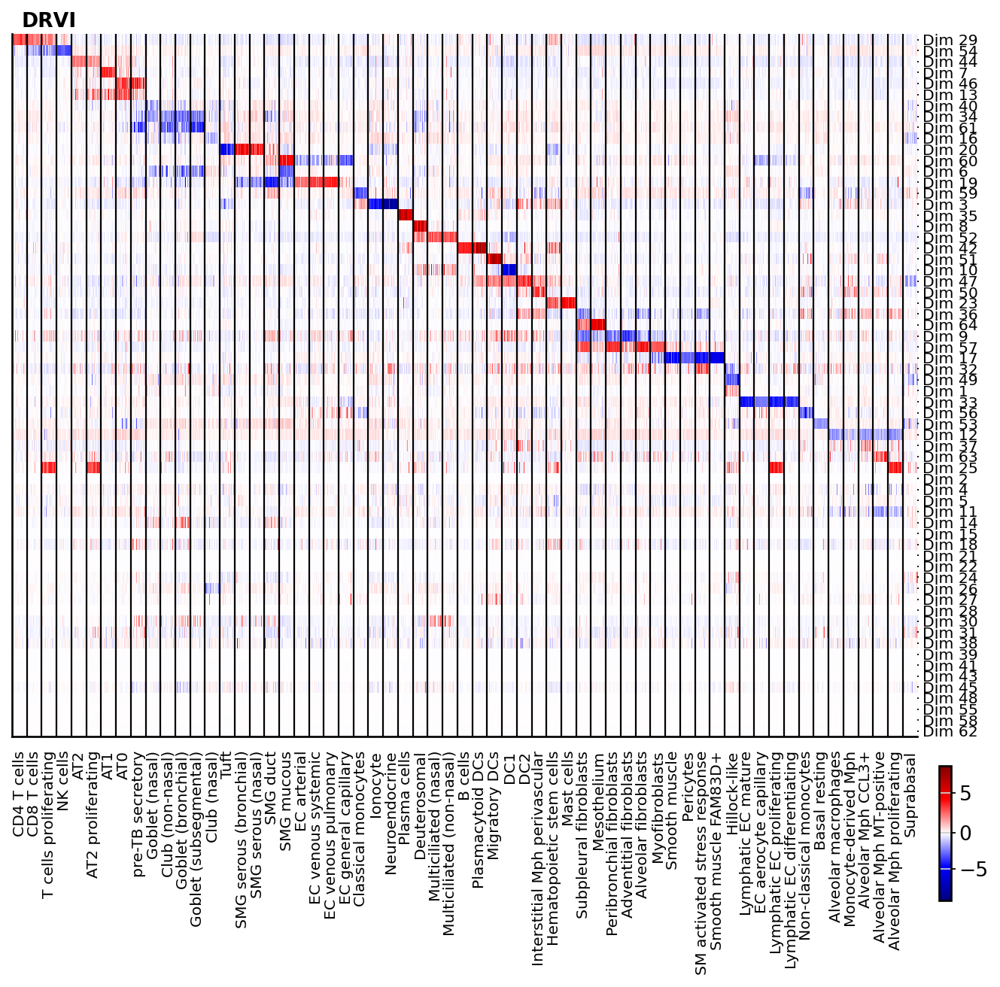

DRVI-IK


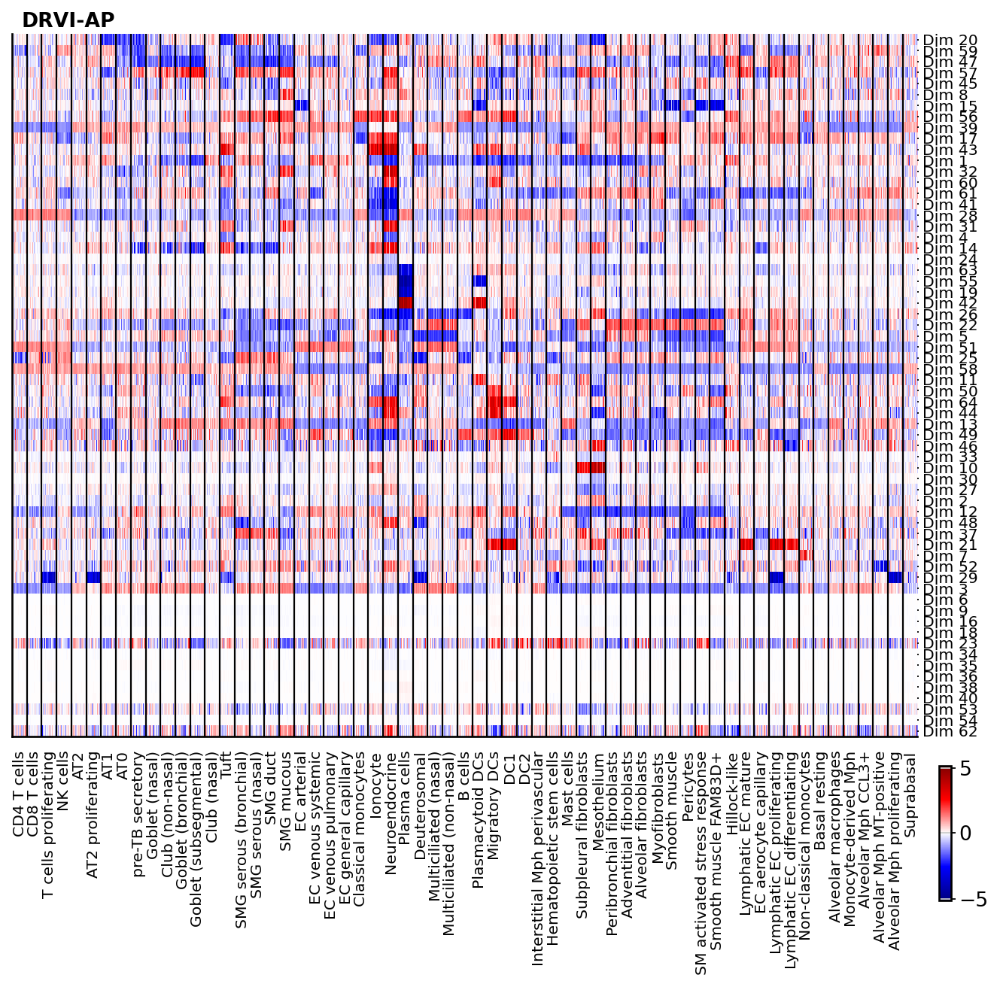

scVI


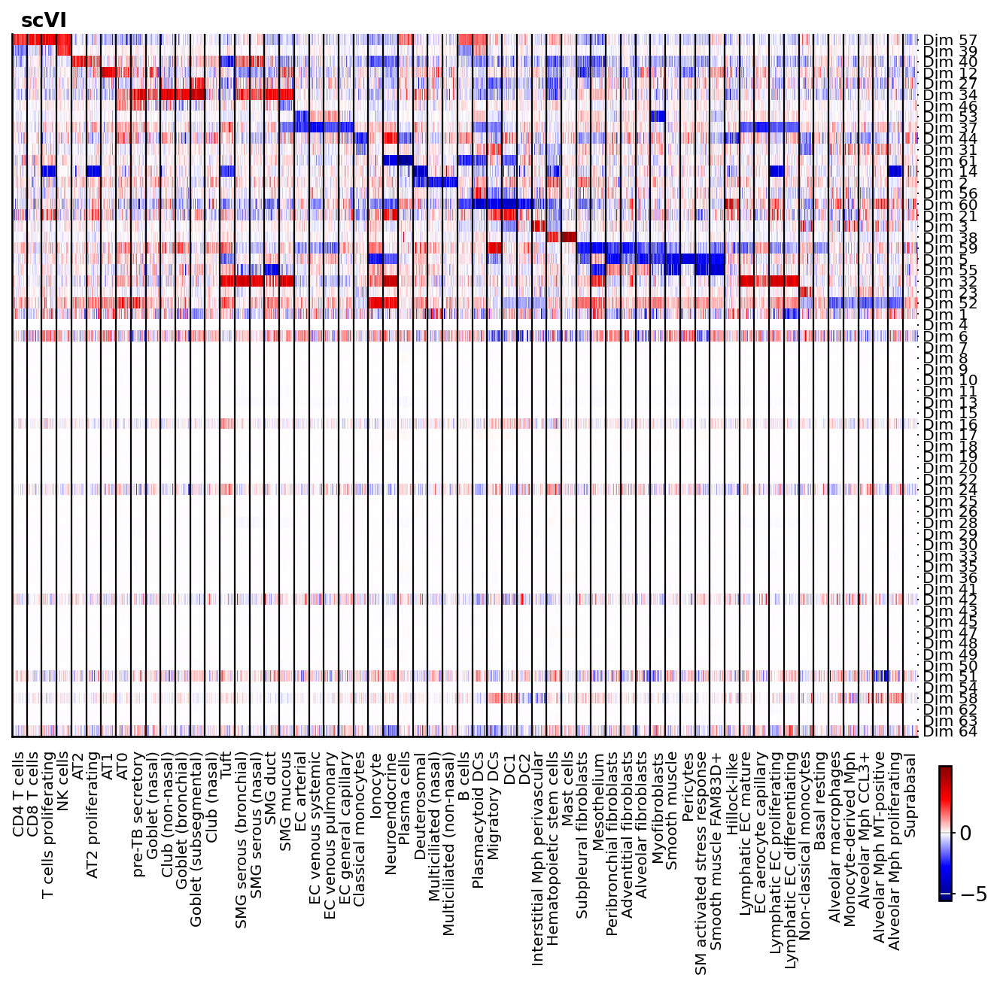

PCA


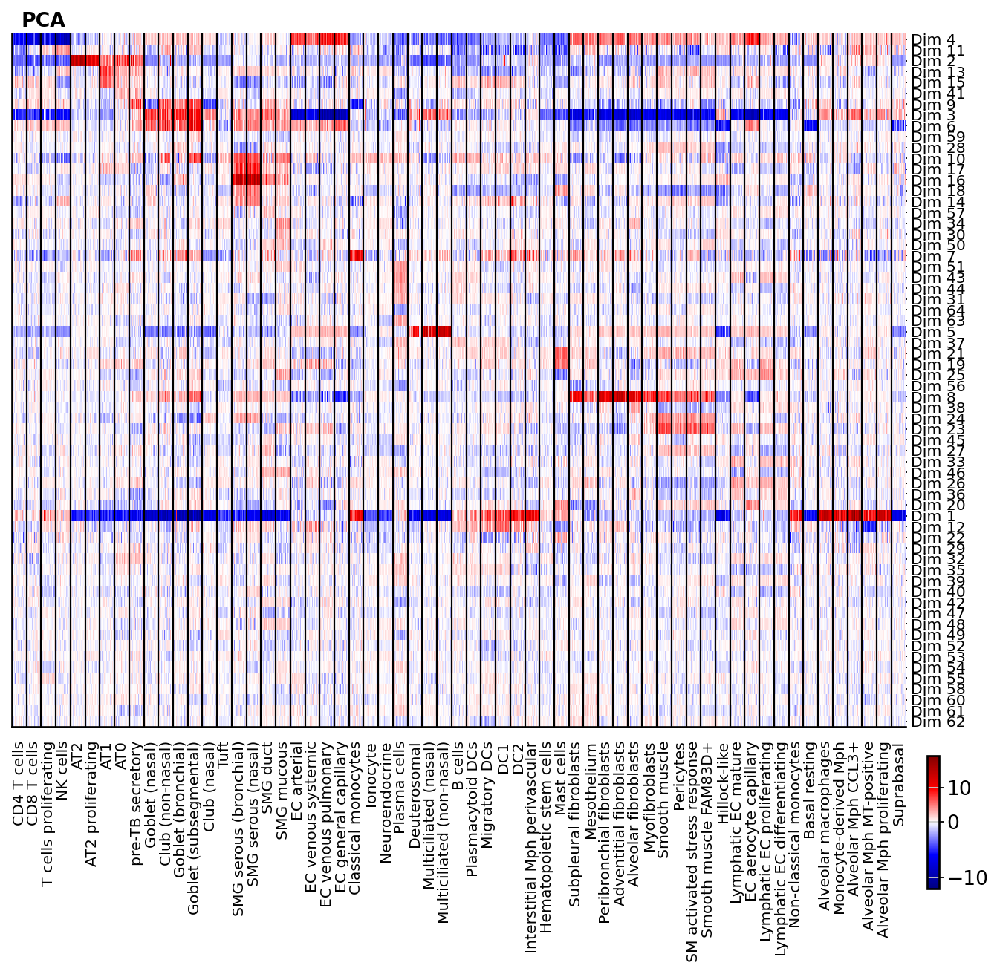

ICA


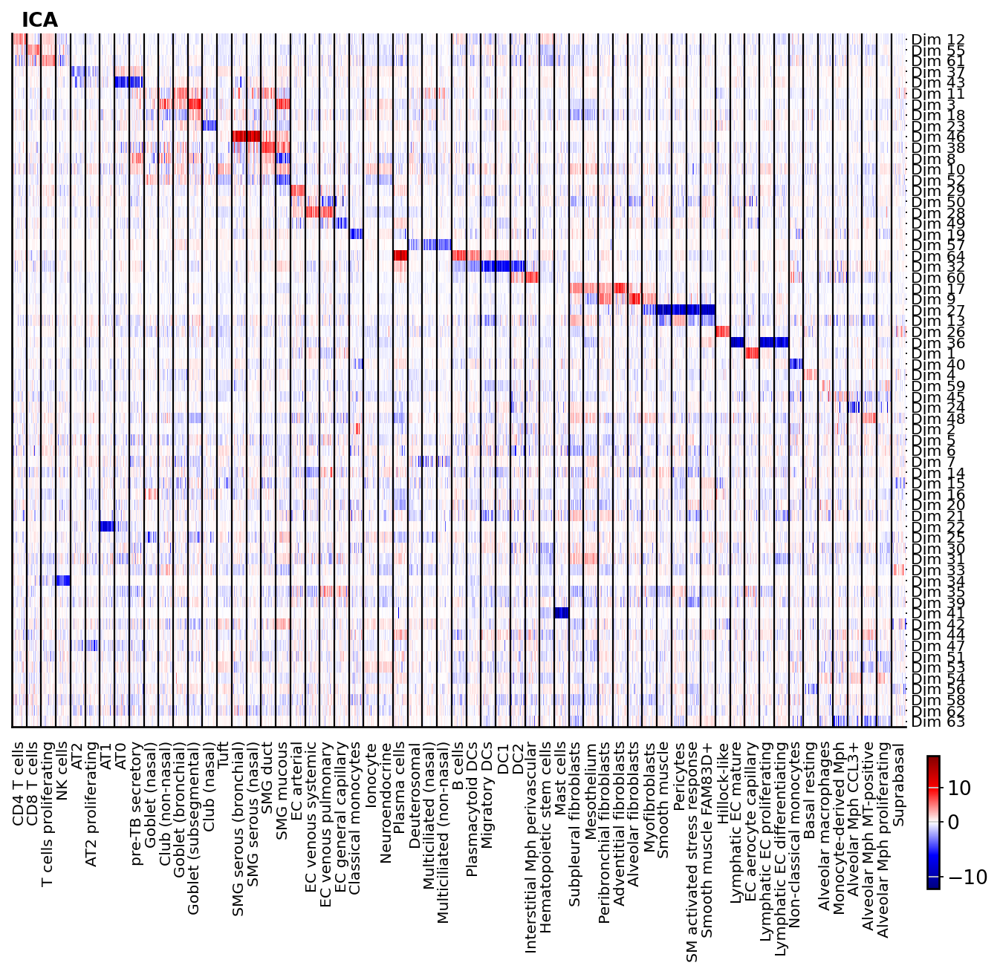

MOFA


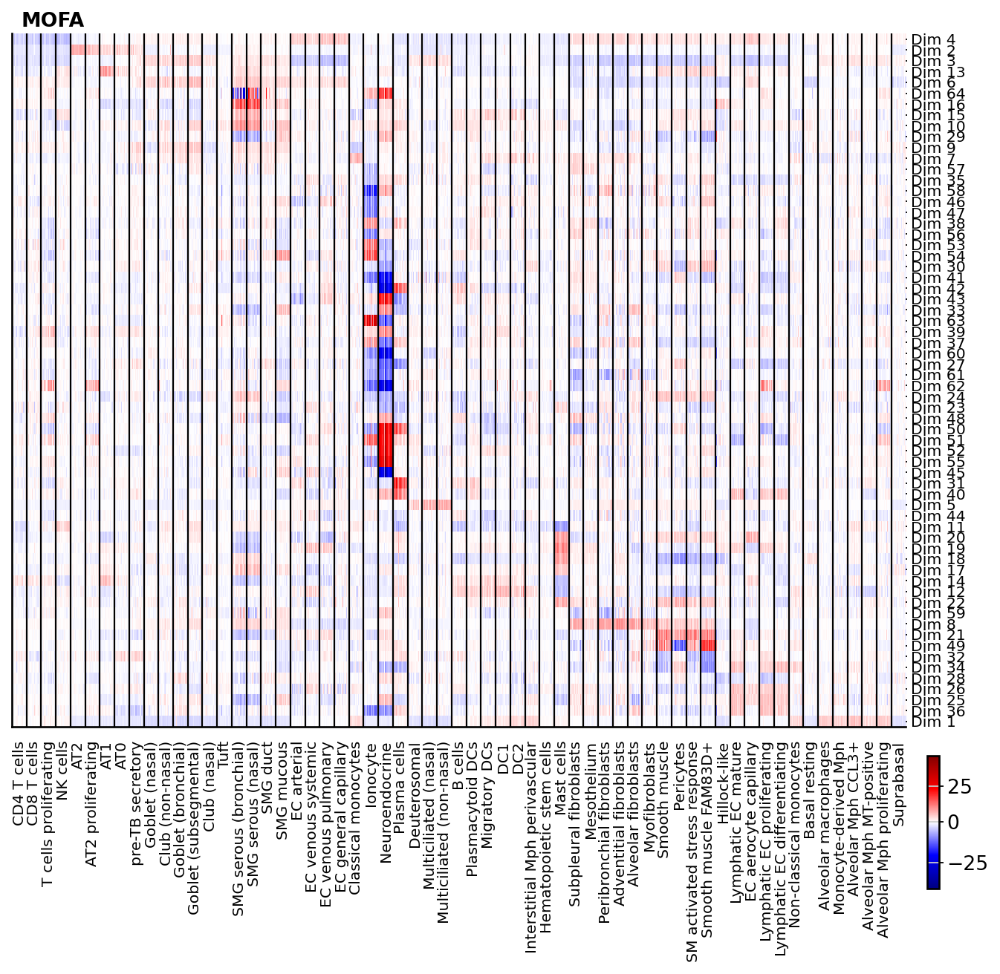

TCVAE-opt


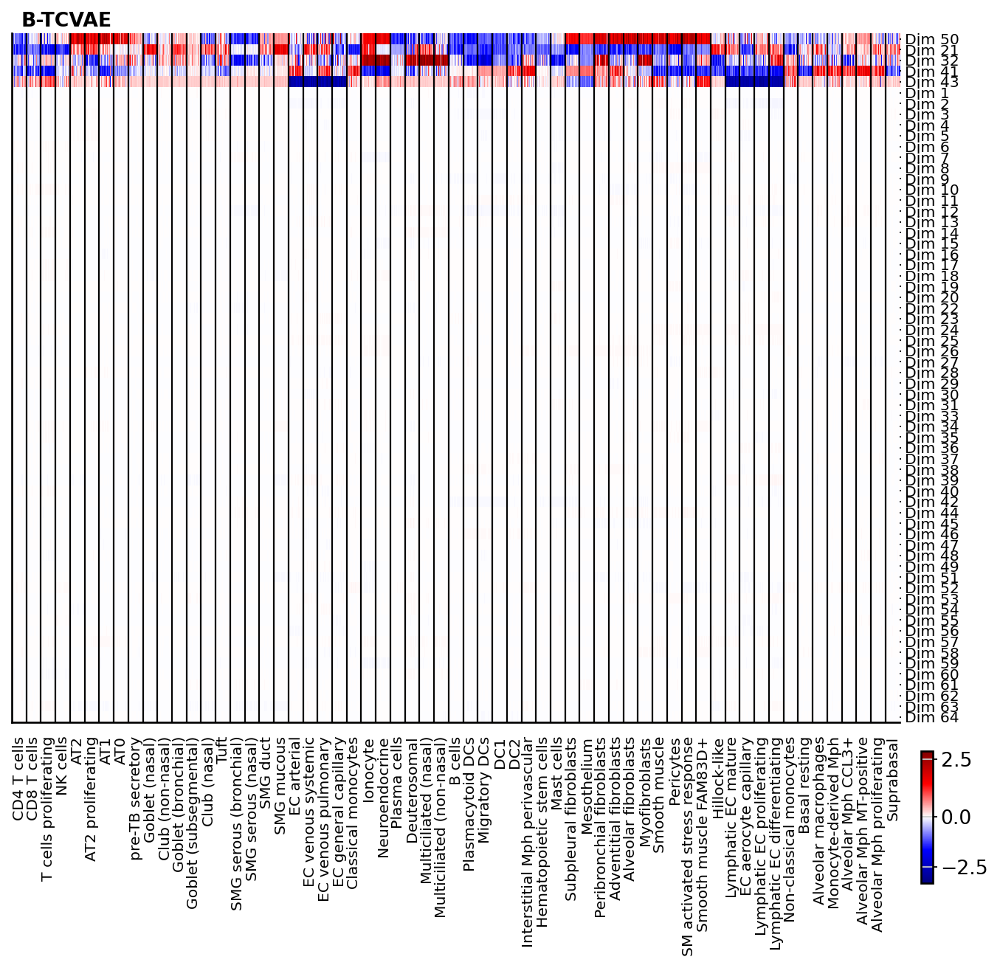

MICHIGAN-opt


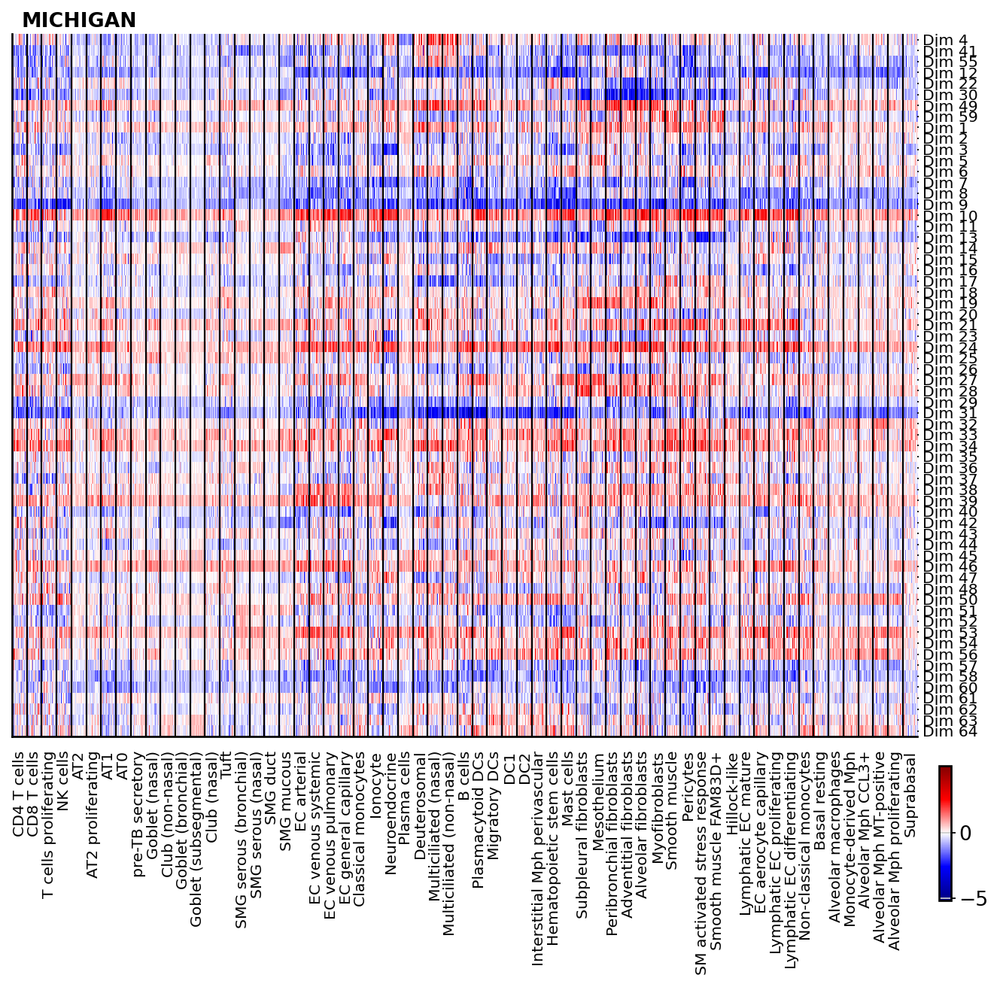

DRVI-CVAE


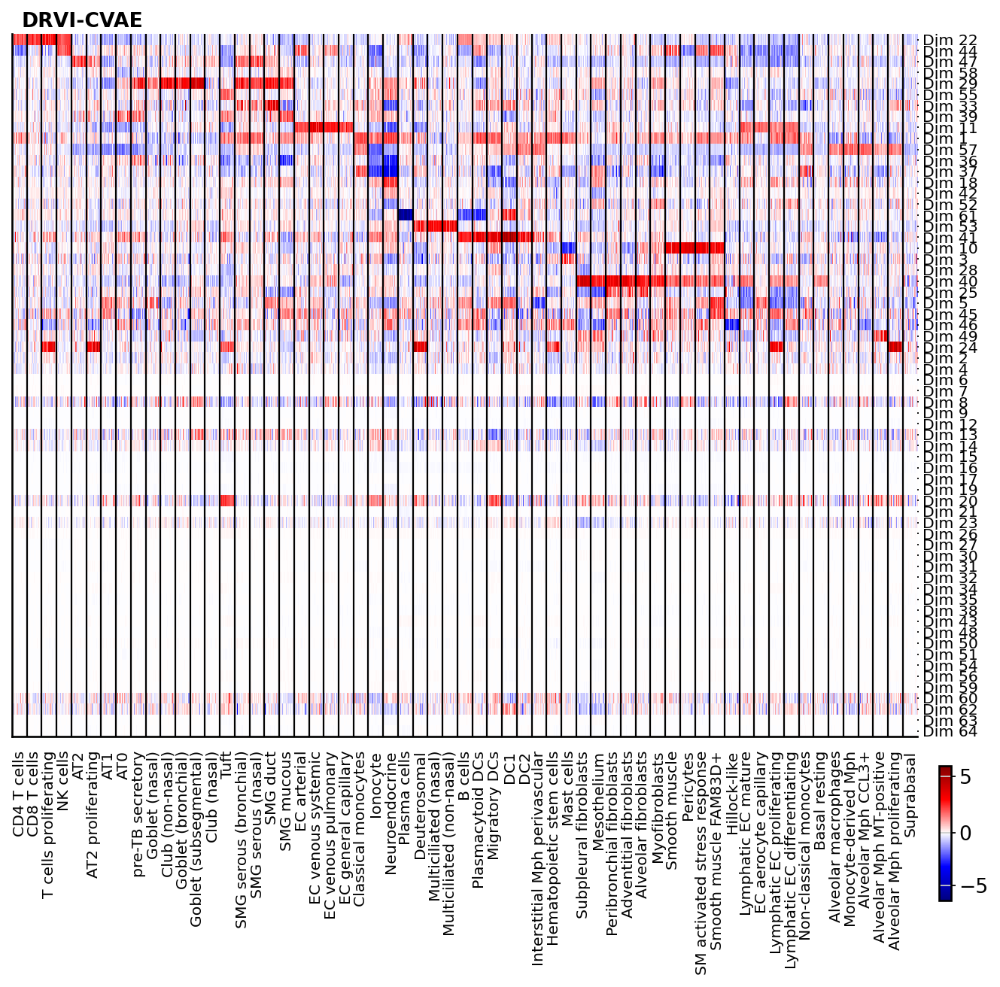

In [20]:
for method_name, embed in embeds.items():
    print(method_name)
    k = cell_type_key
    unique_values = list(sorted(list(embed.obs[k].astype(str).unique())))
    palette = dict(zip(unique_values, cat_100_pallete))
    method_embed_subset = embed[embed_subset.obs.index].copy()
    method_embed_subset.obs[cell_type_key] = pd.Categorical(method_embed_subset.obs[cell_type_key], unique_plot_cts)
    method_embed_subset = method_embed_subset[np.argsort(method_embed_subset.obs[cell_type_key].cat.codes)]
    method_embed_subset.uns[k + "_colors"] = 'black'
    sim_matrix = metric_results[method_name]['Mutual Info Score'][unique_plot_cts].values
    vars = method_embed_subset.var
    vars['van'] = ~ (method_embed_subset.X.max(axis=0, keepdims=True) > method_embed_subset.X.max() / 10).flatten()
    sim_matrix = sim_matrix * ~vars['van'].values[:, np.newaxis]
    vars['plot_order'] = np.hstack([sim_matrix, sim_matrix[:, 0:1] * 0 + 0.3]).argmax(axis=1).tolist()
    if 'title' not in vars.columns:
        vars['title'] = np.char.add('Dim ', (1 + np.arange(method_embed_subset.n_vars)).astype(str))
        vars['order'] = np.arange(method_embed_subset.n_vars)
    vars['not_interesting'] = np.logical_or(vars['van'], vars['plot_order']==sim_matrix.shape[1])
    vars = pd.concat([vars.query('~not_interesting').sort_values('plot_order'), vars.query('not_interesting').sort_values('order')])
    fig = sc.pl.heatmap(
        method_embed_subset,
        vars['title'],
        k,
        gene_symbols = 'title',
        layer=None,
        # var_group_positions=[(0,30), (31, 51), (52, 63)],
        # var_group_labels=['Cell-type indicator', 'Biological Process', 'Vanished'],
        # var_group_rotation=0,
        figsize=(10, 8),
        show_gene_labels=True,
        dendrogram=False,
        vcenter=0,
        cmap=drvi.utils.pl.cmap.saturated_red_blue_cmap, show=False,
        swap_axes=True,
    )
    # fig['groupby_ax'].set_xlabel('Finest level annotation')
    fig['groupby_ax'].set_xlabel('')
    fig['groupby_ax'].get_images()[0].remove()
    pos = fig['groupby_ax'].get_position()
    pos.y0 += 0.015
    fig['groupby_ax'].set_position(pos)
    fig['heatmap_ax'].yaxis.tick_right()
    cbar = fig['heatmap_ax'].figure.get_axes()[-1]
    pos = cbar.get_position()
    # cbar.set_position([1., 0.77, 0.01, 0.13])
    cbar.set_position([.95, 0.001, 0.01, 0.14])

    ax = fig['heatmap_ax']
    ax.set_ylabel('')
    ax.text(0.01, 1.01, pretify_method_name(method_name), size=12, ha='left', weight='bold', color='black', rotation=0, transform=ax.transAxes)

    plt.savefig(output_dir / f"ct_vs_dim_heatmap_rotated_{method_name}.pdf", bbox_inches='tight')
    plt.show()

# DRVI analysis

## DRVI interpretability

In [21]:
embed_drvi = embeds['DRVI']
model_drvi = drvi.model.DRVI.load(RUNS_TO_LOAD['DRVI'] / 'model.pt', adata, prefix='v_0_1_0_')
adata.obsm['X_umap_drvi'] = embed_drvi[adata.obs.index].obsm['X_umap']

INFO     File                                                                                                      
         /home/icb/amirali.moinfar/workspace/train_logs/models/drvi_20240307-160305-403359/model.pt/v_0_1_0_model.p
         t already downloaded                                                                                      


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


INFO     DRVI: The model has been initialized                                                                      


In [22]:
model = model_drvi
embed = embed_drvi

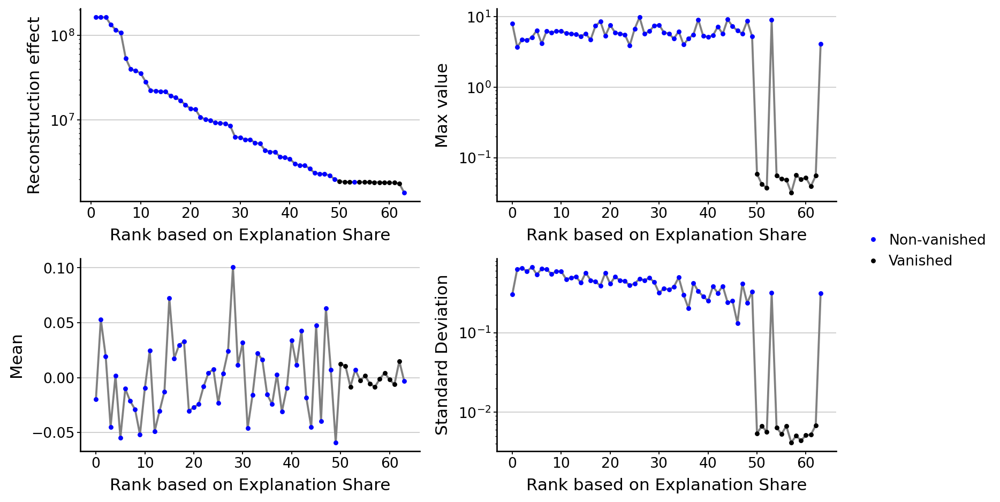

In [23]:
drvi.utils.tl.set_latent_dimension_stats(model, embed)
drvi.utils.pl.plot_latent_dimension_stats(embed, ncols=2)

In [24]:
filename = RUNS_TO_LOAD['DRVI'] / "traverse_adata.h5ad"
if not (filename).exists():
    traverse_adata = drvi.utils.tl.traverse_latent(model, embed, n_samples=200, max_noise_std=0.2)
    drvi.utils.tl.calculate_differential_vars(traverse_adata)
    traverse_adata.write(filename)
else:
    traverse_adata = sc.read(filename)
traverse_adata

AnnData object with n_obs × n_vars = 256000 × 1996
    obs: 'original_order', 'dim_id', 'sample_id', 'step_id', 'span_value', 'lib_size', 'title', 'vanished', 'order'
    var: 'original_order'
    uns: 'combined_score_traverse_effect_neg_dim_ids', 'combined_score_traverse_effect_pos_dim_ids', 'combined_score_traverse_effect_stepwise', 'max_possible_traverse_effect_neg_dim_ids', 'max_possible_traverse_effect_pos_dim_ids', 'max_possible_traverse_effect_stepwise', 'min_possible_traverse_effect_neg_dim_ids', 'min_possible_traverse_effect_pos_dim_ids', 'min_possible_traverse_effect_stepwise'
    obsm: 'cat_covs', 'control_latent', 'effect_latent'
    varm: 'combined_score_traverse_effect_neg', 'combined_score_traverse_effect_pos', 'max_possible_traverse_effect_neg', 'max_possible_traverse_effect_pos', 'min_possible_traverse_effect_neg', 'min_possible_traverse_effect_pos'
    layers: 'control', 'effect'

## Heatmap for figure

In [25]:
# Plot heatmap again for DRVI fig3 with little better sorting and using DR notation for dimensions

ct_dims = ['DR 3', 'DR 7', 'DR 2', 'DR 17', 'DR 34', 'DR 32', 'DR 20', 'DR 14', 'DR 23', 'DR 1', 'DR 8', 'DR 9', 'DR 11', 'DR 27', 'DR 31', 'DR 45', 'DR 5', 'DR 19', 'DR 39', 'DR 30', 'DR 10', 'DR 15', 'DR 47', 'DR 16', 'DR 13', 'DR 18', 'DR 26', 'DR 12', 'DR 22', 'DR 6', 'DR 4']
process_dims = ['DR 21', 'DR 24', 'DR 25', 'DR 28', 'DR 29', 'DR 33', 'DR 35', 'DR 36', 'DR 37', 'DR 38', 'DR 40', 'DR 41', 'DR 42', 'DR 43', 'DR 44', 'DR 46', 'DR 48', 'DR 49', 'DR 50', 'DR 54', 'DR 64']

unique_plot_dims = list(reversed(ct_dims + process_dims))

method_embed_subset = embed[embed_subset.obs.index].copy()
method_embed_subset.var['Cell-type indicator'] = np.where(method_embed_subset.var['title'].isin(ct_dims), 'Yes', 'No')

In [26]:
assert len([ct for ct in unique_plot_cts if ct not in embed_drvi.obs[cell_type_key].unique()]) == 0
assert len([ct for ct in embed_drvi.obs[cell_type_key].unique() if ct not in unique_plot_cts]) == 0

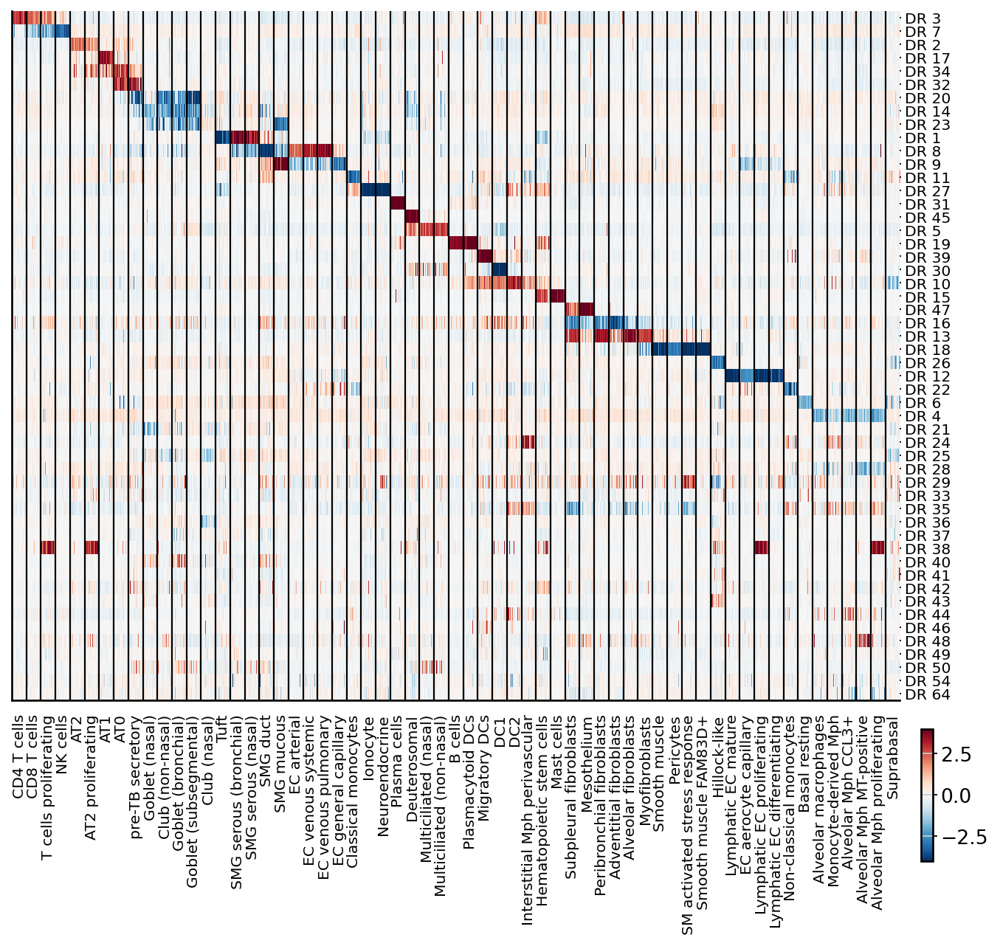

In [27]:
k = cell_type_key
unique_values = list(sorted(list(embed.obs[k].astype(str).unique())))
palette = dict(zip(unique_values, cat_100_pallete))
method_embed_subset.uns[k + "_colors"] = 'black'
unique_values = list(sorted(list(method_embed_subset.obs[k].astype(str).unique())))
palette = dict(zip(unique_values, cat_100_pallete))
method_embed_subset.obs[cell_type_key] = pd.Categorical(method_embed_subset.obs[cell_type_key], unique_plot_cts)
method_embed_subset = method_embed_subset[np.argsort(method_embed_subset.obs[cell_type_key].cat.codes)]
fig = sc.pl.heatmap(
    method_embed_subset,
    unique_plot_dims[::-1],
    k,
    layer=None,
    gene_symbols='title',
    # var_group_positions=[(0,30), (31, 51), (52, 63)],
    # var_group_labels=['Cell-type indicator', 'Biological Process', 'Vanished'],
    # var_group_rotation=0,
    figsize=(10, 8),
    show_gene_labels=True,
    dendrogram=False,
    vcenter=0, vmin=-4, vmax=4,
    cmap='RdBu_r', show=False,
    swap_axes=True,
)
# fig['groupby_ax'].set_xlabel('Finest level annotation')
fig['groupby_ax'].set_xlabel('')
fig['groupby_ax'].get_images()[0].remove()
pos = fig['groupby_ax'].get_position()
pos.y0 += 0.015
fig['groupby_ax'].set_position(pos)
fig['heatmap_ax'].yaxis.tick_right()
cbar = fig['heatmap_ax'].figure.get_axes()[-1]
pos = cbar.get_position()
# cbar.set_position([1., 0.77, 0.01, 0.13])
cbar.set_position([.95, 0.001, 0.01, 0.14])
plt.savefig(output_dir / f"ct_vs_dim_heatmap_rotared.pdf", bbox_inches='tight')
plt.show()

## Interpretability

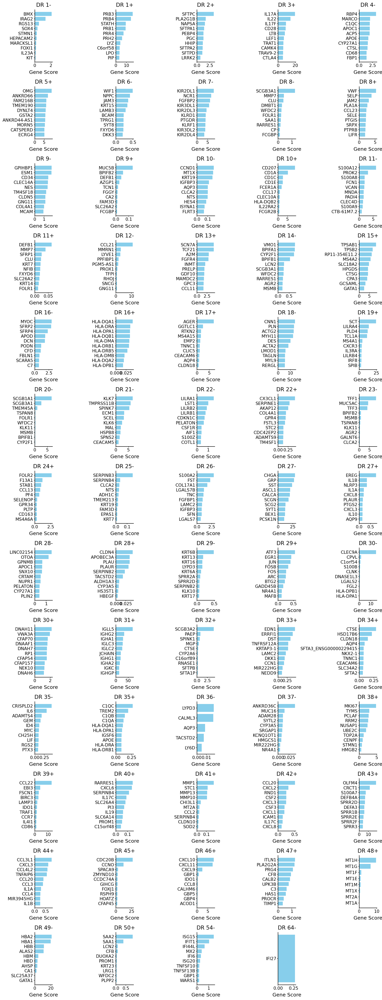

In [28]:
drvi.utils.pl.show_top_differential_vars(traverse_adata, key="combined_score", score_threshold=0.0)

## Interpret each non-cell-type dimension

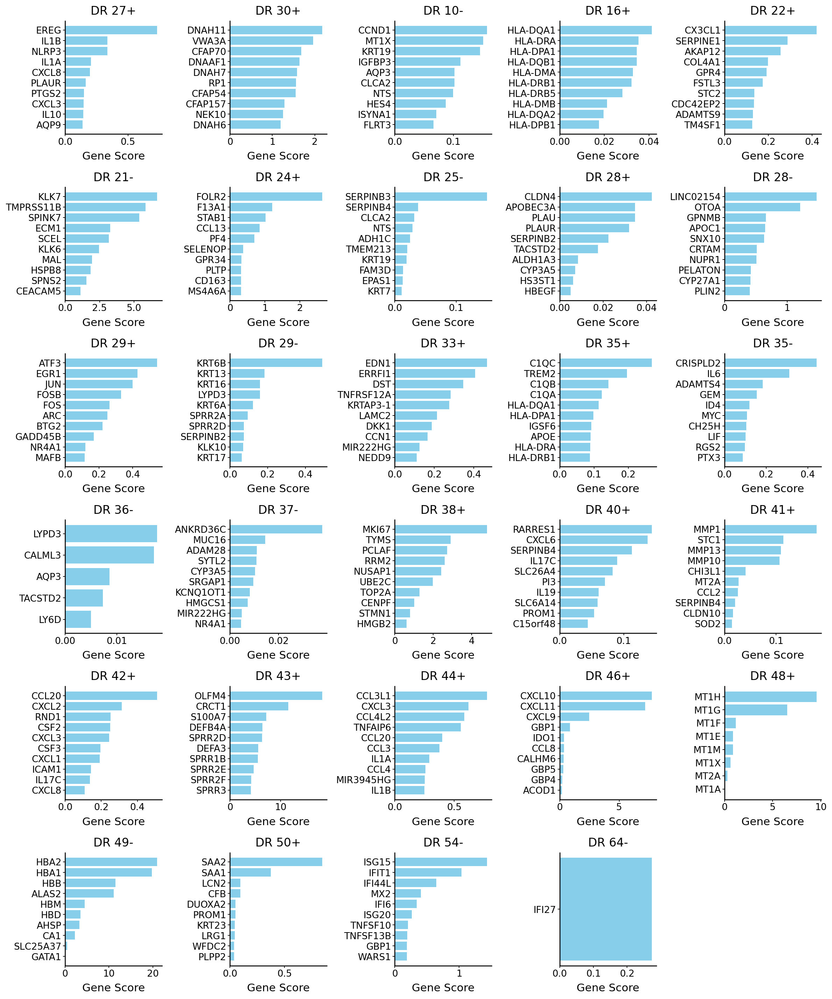

In [29]:
interesting_dims = [
    "DR 27+", "DR 30+", "DR 10-", "DR 16+", "DR 22+", "DR 21-", "DR 24+", "DR 25-", "DR 28+", "DR 28-", 
    "DR 29+", "DR 29-", "DR 33+", "DR 35+", "DR 35-", "DR 36-", "DR 37-", "DR 38+", "DR 40+", "DR 41+", 
    "DR 42+", "DR 43+", "DR 44+", "DR 46+", "DR 48+", "DR 49-", "DR 50+", "DR 54-", "DR 64-" 
]
fig = drvi.utils.pl.show_top_differential_vars(traverse_adata, key="combined_score", dim_subset=interesting_dims, score_threshold=0.0, show=False)
plt.tight_layout()
fig.savefig(output_dir / f'drvi_interpretability_for_process_dimensions.pdf', bbox_inches='tight', dpi=200)
plt.show()

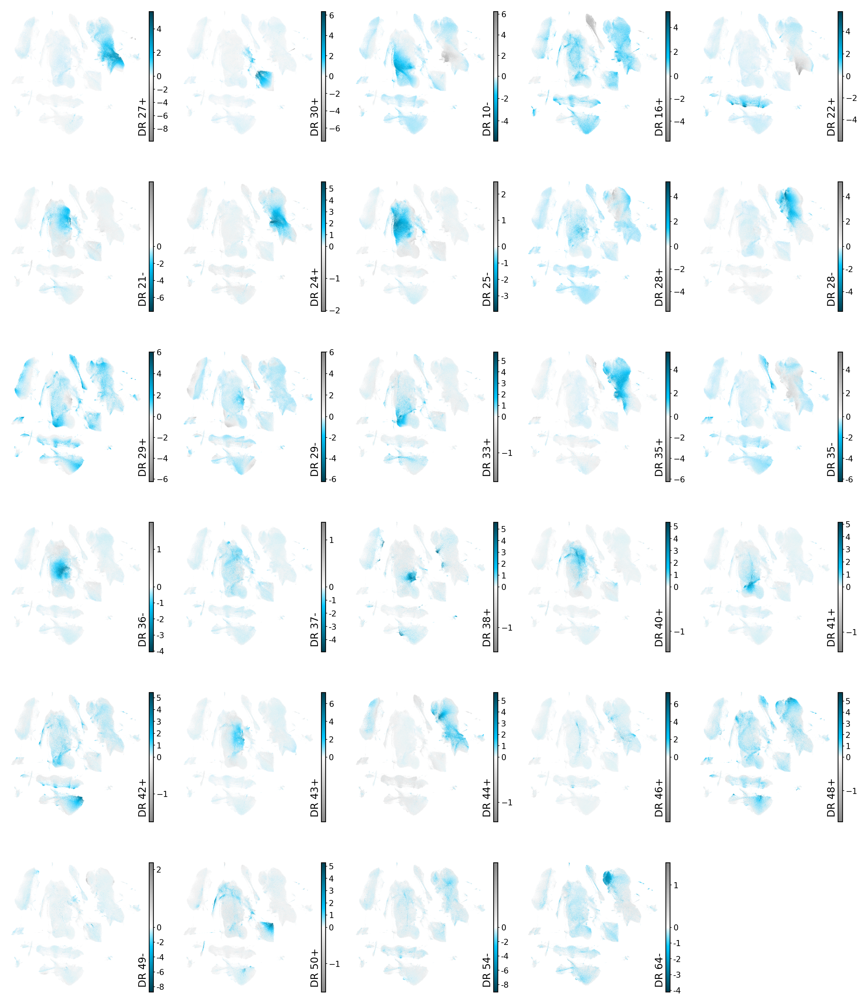

In [30]:
fig = drvi.utils.pl.plot_latent_dims_in_umap(embed, directional=True, ncols=5, show=False, wspace=0.1, hspace=0.25, color_bar_rescale_ratio=0.95,
                                             dim_subset=interesting_dims)
fig.savefig(output_dir / f'drvi_interesting_nonct_latents_on_umap.pdf', bbox_inches='tight', dpi=300)
plt.show()

## GSEA for all dims

In [31]:
gp = GProfiler(return_dataframe=True)

for dim_title, gene_scores in drvi.utils.tl.iterate_on_top_differential_vars(
    traverse_adata, key="combined_score", score_threshold=0.0,
):
    print(dim_title)

    gene_scores = gene_scores[gene_scores > gene_scores.max() / 10]
    print(gene_scores)

    relevant_genes = gene_scores.index.to_list()[:100]

    relevant_pathways = gp.profile(
        organism="hsapiens", query=relevant_genes, background=list(adata.var.index), domain_scope="custom"
    )
    display(relevant_pathways[:10])

DR 1-
feature_name
BMX         2.075655
IRAG2       1.320274
RGS13       0.511798
SOX4        0.348823
STMN1       0.261914
HEPACAM2    0.241527
Name: 19, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 1+
feature_name
PRB3             15.981224
PRB4             14.336514
STATH             9.392418
PRB1              9.248883
PRR4              7.341985
PRH2              5.989851
LYZ               4.256616
C6orf58           3.690577
LPO               3.567074
PIP               3.364501
ZG16B             3.281643
RP11-1143G9.4     3.119820
LTF               2.850787
S100A1            2.655692
MUC7              2.312501
ODAM              2.098915
Name: 19, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,KEGG,KEGG:04970,Salivary secretion,0.000015,True,Salivary secretion,16,14,6,1957,0.428571,0.375000,query_1,[KEGG:00000]
1,TF,TF:M02112_1,Factor: OC-2; motif: TCAATA; match class: 1,0.004682,True,Factor: OC-2; motif: TCAATA; match class: 1,277,14,11,1957,0.785714,0.039711,query_1,[TF:M02112]


DR 2+
feature_name
SFTPC                    3.281976
PLA2G1B                  1.722188
NAPSA                    1.554975
SFTPA1                   1.409107
PEBP4                    1.262460
PGC                      1.259509
HHIP                     1.143416
SFTPA2                   1.109165
SFTPD                    1.066469
LRRK2                    0.689815
SFTPB                    0.675776
ABCA3                    0.659393
SFTA3_ENSG00000229415    0.646189
MFSD2A                   0.638203
SFTA2                    0.562443
C16orf89                 0.542846
SLC34A2                  0.472087
SDR16C5                  0.446547
GKN2                     0.442563
FASN                     0.402631
LAMP3                    0.399511
ALPL                     0.378194
WIF1                     0.375475
MALL                     0.373124
SELENBP1                 0.359951
HSD17B6                  0.355317
LPCAT1                   0.340697
CSF3R                    0.336667
TTN                      0.33

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,REAC,REAC:R-HSA-5683826,Surfactant metabolism,1.409807e-08,True,Surfactant metabolism,12,28,8,1957,0.285714,0.666667,query_1,[REAC:R-HSA-392499]
1,REAC,REAC:R-HSA-5687613,Diseases associated with surfactant metabolism,2.174076e-08,True,Diseases associated with surfactant metabolism,8,28,7,1957,0.250000,0.875000,query_1,[REAC:R-HSA-5668914]
2,GO:CC,GO:0042599,lamellar body,9.691126e-08,True,"""A membrane-bounded organelle, specialized for...",9,28,7,1957,0.250000,0.777778,query_1,[GO:0030141]
3,GO:CC,GO:0005771,multivesicular body,6.613024e-07,True,"""A type of endosome in which regions of the li...",17,28,8,1957,0.285714,0.470588,query_1,[GO:0005770]
4,GO:CC,GO:0097208,alveolar lamellar body,2.064825e-05,True,"""A specialized secretory organelle found in ty...",5,28,5,1957,0.178571,1.000000,query_1,[GO:0042599]
5,HPA,HPA:0301372,lung; alveolar cells type II[≥Medium],5.307646e-05,True,lung; alveolar cells type II[≥Medium],93,28,12,1957,0.428571,0.129032,query_1,[HPA:0301371]
6,HPA,HPA:0301373,lung; alveolar cells type II[High],5.895992e-05,True,lung; alveolar cells type II[High],55,28,10,1957,0.357143,0.181818,query_1,[HPA:0301372]
7,HP,HP:0025179,Ground-glass opacification,1.070712e-04,True,"On chest radiographs, ground-glass opacity app...",11,28,6,1957,0.214286,0.545455,query_1,[HP:0031457]
8,HP,HP:0031630,Abnormal subpleural morphology,1.226730e-04,True,Any structural anomaly located between the ple...,6,28,5,1957,0.178571,0.833333,query_1,[HP:0002088]
9,REAC,REAC:R-HSA-5688890,Defective CSF2RA causes SMDP4,1.226730e-04,True,Defective CSF2RA causes SMDP4,6,28,5,1957,0.178571,0.833333,query_1,[REAC:R-HSA-5687613]


DR 3+
feature_name
IL17A             19.470156
IL22              14.434462
IL17F              9.159310
CD28               8.743587
LTB                7.944405
LEF1               6.748518
TRAT1              6.163431
CAMK4              6.082166
TRAV9-2            5.878717
CTLA4              5.724258
PARP11-AS1         5.637942
SIRPG              5.491081
IL2RA              5.322392
RP11-1399P15.1     5.286160
IL21               4.985048
LINC02273          4.616835
TNFRSF25           4.527314
ICOS               4.092808
TNFRSF4            4.088245
LTA                3.969998
CCR4               3.761020
CD40LG             3.547512
SELL               3.315145
CD3G               3.240535
BCL11B             3.215278
TRBV6-2            3.178562
CD3E               2.945407
CCR6               2.925981
SPOCK2             2.662773
TRAV25             2.546670
TNFRSF18           2.465928
IL7R               2.412190
IL2                2.276528
TIGIT              2.257993
CD5                2.239855
C

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0002520,immune system development,3.652970e-09,True,"""The process whose specific outcome is the pro...",40,39,13,1957,0.333333,0.325000,query_1,"[GO:0002376, GO:0048731]"
1,KEGG,KEGG:04060,Cytokine-cytokine receptor interaction,2.846474e-08,True,Cytokine-cytokine receptor interaction,117,39,18,1957,0.461538,0.153846,query_1,[KEGG:00000]
2,GO:BP,GO:0042110,T cell activation,7.988992e-08,True,"""The change in morphology and behavior of a ma...",186,39,21,1957,0.538462,0.112903,query_1,[GO:0046649]
3,GO:BP,GO:0050863,regulation of T cell activation,1.937972e-06,True,"""Any process that modulates the frequency, rat...",128,39,17,1957,0.435897,0.132812,query_1,"[GO:0042110, GO:0051249]"
4,GO:BP,GO:0007159,leukocyte cell-cell adhesion,1.081732e-05,True,"""The attachment of a leukocyte to another cell...",142,39,17,1957,0.435897,0.119718,query_1,[GO:0098609]
5,GO:BP,GO:0046649,lymphocyte activation,1.107185e-05,True,"""A change in morphology and behavior of a lymp...",238,39,21,1957,0.538462,0.088235,query_1,[GO:0045321]
6,GO:BP,GO:0051249,regulation of lymphocyte activation,1.120182e-05,True,"""Any process that modulates the frequency, rat...",164,39,18,1957,0.461538,0.109756,query_1,"[GO:0002694, GO:0046649]"
7,GO:BP,GO:0002376,immune system process,1.201917e-05,True,"""Any process involved in the development or fu...",694,39,33,1957,0.846154,0.047550,query_1,[GO:0008150]
8,GO:BP,GO:0051251,positive regulation of lymphocyte activation,1.215069e-05,True,"""Any process that activates or increases the f...",104,39,15,1957,0.384615,0.144231,query_1,"[GO:0002696, GO:0046649, GO:0051249]"
9,GO:BP,GO:0050870,positive regulation of T cell activation,1.478293e-05,True,"""Any process that activates or increases the f...",88,39,14,1957,0.358974,0.159091,query_1,"[GO:0042110, GO:0050863, GO:0051251, GO:1903039]"


DR 4-
feature_name
RBP4      3.155078
MARCO     2.038692
C1QC      1.998881
APOC1     1.989213
ACP5      1.975218
            ...   
TGM2      0.362093
OTOA      0.355261
PLIN2     0.351854
LGALS1    0.334006
CFD       0.326828
Name: 11, Length: 72, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,HPA,HPA:0300413,lung; macrophages[High],1.207970e-12,True,lung; macrophages[High],111,70,27,1957,0.385714,0.243243,query_1,[HPA:0300412]
1,HPA,HPA:0300412,lung; macrophages[≥Medium],5.260209e-10,True,lung; macrophages[≥Medium],334,70,40,1957,0.571429,0.119760,query_1,[HPA:0300411]
2,GO:BP,GO:0002504,antigen processing and presentation of peptide...,3.589193e-07,True,"""The process in which an antigen-presenting ce...",20,70,11,1957,0.157143,0.550000,query_1,[GO:0019882]
3,KEGG,KEGG:04145,Phagosome,5.554699e-07,True,Phagosome,39,70,14,1957,0.200000,0.358974,query_1,[KEGG:00000]
4,KEGG,KEGG:05322,Systemic lupus erythematosus,9.543541e-07,True,Systemic lupus erythematosus,27,70,12,1957,0.171429,0.444444,query_1,[KEGG:00000]
5,GO:BP,GO:0048002,antigen processing and presentation of peptide...,1.424626e-06,True,"""The process in which an antigen-presenting ce...",22,70,11,1957,0.157143,0.500000,query_1,[GO:0019882]
6,HPA,HPA:0300411,lung; macrophages[≥Low],2.216100e-06,True,lung; macrophages[≥Low],510,70,44,1957,0.628571,0.086275,query_1,[HPA:0300000]
7,GO:BP,GO:0002495,antigen processing and presentation of peptide...,3.115648e-06,True,"""The process in which an antigen-presenting ce...",18,70,10,1957,0.142857,0.555556,query_1,"[GO:0002504, GO:0048002]"
8,GO:BP,GO:0002478,antigen processing and presentation of exogeno...,6.392877e-06,True,"""The process in which an antigen-presenting ce...",19,70,10,1957,0.142857,0.526316,query_1,"[GO:0019884, GO:0048002]"
9,GO:BP,GO:0019882,antigen processing and presentation,6.744828e-06,True,"""The process in which an antigen-presenting ce...",38,70,13,1957,0.185714,0.342105,query_1,[GO:0002376]


DR 5+
feature_name
OMG        8.893455
ANKRD66    6.976590
FAM216B    6.083292
TMEM190    6.050524
DYNLT4     5.757568
             ...   
VWA3A      0.941762
CRACDL     0.931158
WDR49      0.926541
CHST9      0.920792
DHRS9      0.889549
Name: 51, Length: 209, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0005929,cilium,5.262874e-31,True,"""A specialized eukaryotic organelle that consi...",131,91,48,1957,0.527473,0.366412,query_1,"[GO:0043227, GO:0120025]"
1,HPA,HPA:0060881,bronchus; ciliated cells (tip of cilia)[≥Low],5.597149e-29,True,bronchus; ciliated cells (tip of cilia)[≥Low],113,91,44,1957,0.483516,0.389381,query_1,[HPA:0060000]
2,HPA,HPA:0210882,fallopian tube; ciliated cells (tip of cilia)[...,2.060220e-25,True,fallopian tube; ciliated cells (tip of cilia)[...,125,91,43,1957,0.472527,0.344000,query_1,[HPA:0210881]
3,HPA,HPA:0060882,bronchus; ciliated cells (tip of cilia)[≥Medium],2.540940e-25,True,bronchus; ciliated cells (tip of cilia)[≥Medium],104,91,40,1957,0.439560,0.384615,query_1,[HPA:0060881]
4,HPA,HPA:0210881,fallopian tube; ciliated cells (tip of cilia)[...,3.383227e-25,True,fallopian tube; ciliated cells (tip of cilia)[...,134,91,44,1957,0.483516,0.328358,query_1,[HPA:0210000]
5,HPA,HPA:0060862,bronchus; ciliated cells (cilia axoneme)[≥Medium],5.190903e-22,True,bronchus; ciliated cells (cilia axoneme)[≥Medium],75,91,33,1957,0.362637,0.440000,query_1,[HPA:0060861]
6,HPA,HPA:0060861,bronchus; ciliated cells (cilia axoneme)[≥Low],1.511093e-21,True,bronchus; ciliated cells (cilia axoneme)[≥Low],77,91,33,1957,0.362637,0.428571,query_1,[HPA:0060000]
7,HPA,HPA:0210883,fallopian tube; ciliated cells (tip of cilia)[...,2.895019e-21,True,fallopian tube; ciliated cells (tip of cilia)[...,91,91,35,1957,0.384615,0.384615,query_1,[HPA:0210882]
8,GO:CC,GO:0031514,motile cilium,1.157971e-20,True,"""A cilium which may have a variable arrangemen...",69,91,31,1957,0.340659,0.449275,query_1,[GO:0005929]
9,HPA,HPA:0210871,fallopian tube; ciliated cells (ciliary rootle...,4.809092e-20,True,fallopian tube; ciliated cells (ciliary rootle...,136,91,40,1957,0.439560,0.294118,query_1,[HPA:0210000]


DR 6-
feature_name
WIF1      0.495191
NPPC      0.415044
JAM3      0.362865
KRT15     0.340624
LAMB3     0.285356
            ...   
NRG1      0.051677
MMP2      0.051604
SFN       0.051491
LHFPL6    0.050204
CH25H     0.049688
Name: 52, Length: 85, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0048513,animal organ development,0.001081,True,"""Development of a tissue or tissues that work ...",446,84,42,1957,0.500000,0.094170,query_1,[GO:0048856]
1,GO:BP,GO:0007167,enzyme-linked receptor protein signaling pathway,0.001129,True,"""The series of molecular signals initiated by ...",177,84,25,1957,0.297619,0.141243,query_1,[GO:0007166]
2,TF,TF:M12345,Factor: Zbtb37; motif: NYACCGCRNTCACCGCR,0.002519,True,Factor: Zbtb37; motif: NYACCGCRNTCACCGCR,369,84,37,1957,0.440476,0.100271,query_1,[TF:M00000]
3,TF,TF:M04863_1,Factor: TF3C-beta; motif: CCNGGAGGGCTTCCTGGAGG...,0.003488,True,Factor: TF3C-beta; motif: CCNGGAGGGCTTCCTGGAGG...,705,84,54,1957,0.642857,0.076596,query_1,[TF:M04863]
4,TF,TF:M00716_1,Factor: ZF5; motif: GSGCGCGR; match class: 1,0.009330,True,Factor: ZF5; motif: GSGCGCGR; match class: 1,1011,84,66,1957,0.785714,0.065282,query_1,[TF:M00716]
5,GO:BP,GO:0060429,epithelium development,0.016455,True,"""The process whose specific outcome is the pro...",216,84,26,1957,0.309524,0.120370,query_1,[GO:0009888]
6,HP,HP:0001072,Thickened skin,0.018866,True,Laminar thickening of skin.,67,84,14,1957,0.166667,0.208955,query_1,[HP:0011121]
7,TF,TF:M01219,Factor: SP1:SP3; motif: CCSCCCCCYCC,0.020226,True,Factor: SP1:SP3; motif: CCSCCCCCYCC,490,84,42,1957,0.500000,0.085714,query_1,[TF:M00000]
8,TF,TF:M07206,Factor: E2F-1; motif: NGGGCGGGARV,0.021135,True,Factor: E2F-1; motif: NGGGCGGGARV,1137,84,70,1957,0.833333,0.061566,query_1,[TF:M00000]
9,HP,HP:0000137,Abnormality of the ovary,0.021248,True,An abnormality of the ovary.,19,84,8,1957,0.095238,0.421053,query_1,[HP:0000008]


DR 7-
feature_name
KIR2DL1     7.834448
NCR1        6.656257
FGFBP2      6.125519
KIR3DL1     5.614105
KIR2DL3     4.422790
              ...   
APOBEC3G    0.793765
HCST        0.793017
ADAM8       0.791896
CD53        0.786568
SLA         0.784653
Name: 53, Length: 87, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,KEGG,KEGG:04650,Natural killer cell mediated cytotoxicity,6.950193e-13,True,Natural killer cell mediated cytotoxicity,42,85,20,1957,0.235294,0.476190,query_1,[KEGG:00000]
1,GO:BP,GO:0002228,natural killer cell mediated immunity,1.651786e-08,True,"""The promotion of an immune response by natura...",32,85,15,1957,0.176471,0.468750,query_1,"[GO:0002449, GO:0045087]"
2,GO:BP,GO:0042267,natural killer cell mediated cytotoxicity,6.609052e-08,True,"""The directed killing of a target cell by a na...",29,85,14,1957,0.164706,0.482759,query_1,"[GO:0001909, GO:0002228]"
3,GO:BP,GO:0001909,leukocyte mediated cytotoxicity,3.304878e-06,True,"""The directed killing of a target cell by a le...",58,85,17,1957,0.200000,0.293103,query_1,"[GO:0001906, GO:0002443]"
4,GO:BP,GO:0002715,regulation of natural killer cell mediated imm...,3.393790e-06,True,"""Any process that modulates the frequency, rat...",25,85,12,1957,0.141176,0.480000,query_1,"[GO:0002228, GO:0002706, GO:0045088]"
5,GO:BP,GO:0042269,regulation of natural killer cell mediated cyt...,1.296354e-05,True,"""Any process that modulates the frequency, rat...",22,85,11,1957,0.129412,0.500000,query_1,"[GO:0001910, GO:0002715, GO:0042267]"
6,GO:BP,GO:0001906,cell killing,2.467890e-05,True,"""Any process in an organism that results in th...",83,85,19,1957,0.223529,0.228916,query_1,[GO:0009987]
7,GO:BP,GO:0002443,leukocyte mediated immunity,6.942170e-05,True,"""Any process involved in the carrying out of a...",166,85,26,1957,0.305882,0.156627,query_1,[GO:0002252]
8,REAC,REAC:R-HSA-198933,Immunoregulatory interactions between a Lympho...,1.841828e-04,True,Immunoregulatory interactions between a Lympho...,103,85,20,1957,0.235294,0.194175,query_1,[REAC:R-HSA-1280218]
9,GO:BP,GO:0006955,immune response,1.996509e-04,True,"""Any immune system process that functions in t...",566,85,50,1957,0.588235,0.088339,query_1,"[GO:0002376, GO:0050896]"


DR 8-
feature_name
SCGB3A1    1.214049
MMP7       0.425402
CLU        0.390927
DMBT1      0.281985
WFDC2      0.247202
FOLR1      0.228803
SAA1       0.205537
RARRES1    0.178907
CP         0.138020
FCGBP      0.131790
KDR        0.130255
KRT7       0.124861
Name: 18, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 8+
feature_name
VWF                     5.269627
SELP                    3.865546
JAM2                    3.004697
PLA1A                   2.565944
CCL23                   2.250679
SELE                    2.171706
PTGIS                   2.110658
SRPX                    2.033242
PTPRB                   1.963664
LIFR                    1.856518
ACKR1                   1.764454
MMRN2                   1.747797
PTGS1                   1.707451
VCAM1                   1.664123
SULT1E1                 1.410884
RAMP3                   1.409571
CLU                     1.373694
AQP1                    1.356587
TEK                     1.337147
TSPAN7                  1.323107
CCL14                   1.318907
NRN1                    1.307367
SOX18                   1.293498
EGFL7                   1.272827
CLEC14A                 1.066475
HSPG2                   1.050143
RAMP2                   1.021760
CALCRL                  0.991862
FAM167B                 0.990718
SLCO2A1                 

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0001568,blood vessel development,0.000732,True,"""The process whose specific outcome is the pro...",203,58,22,1957,0.379310,0.108374,query_1,"[GO:0001944, GO:0048856]"
1,GO:BP,GO:0001525,angiogenesis,0.000918,True,"""Blood vessel formation when new vessels emerg...",169,58,20,1957,0.344828,0.118343,query_1,"[GO:0048514, GO:0048646]"
2,GO:BP,GO:0048514,blood vessel morphogenesis,0.001027,True,"""The process in which the anatomical structure...",188,58,21,1957,0.362069,0.111702,query_1,"[GO:0001568, GO:0035239]"
3,GO:BP,GO:0072359,circulatory system development,0.001848,True,"""The process whose specific outcome is the pro...",274,58,25,1957,0.431034,0.091241,query_1,[GO:0048731]
4,GO:BP,GO:0001944,vasculature development,0.002391,True,"""The process whose specific outcome is the pro...",216,58,22,1957,0.379310,0.101852,query_1,"[GO:0048731, GO:0072359]"
5,GO:BP,GO:0035239,tube morphogenesis,0.014876,True,"""The process in which the anatomical structure...",218,58,21,1957,0.362069,0.096330,query_1,"[GO:0009653, GO:0035295]"


DR 9-
feature_name
GPIHBP1    1.809795
ESM1       1.790997
CD34       1.443423
CLEC14A    1.418053
NES        1.390486
             ...   
TM4SF1     0.185286
PLK2       0.184898
CAV2       0.183714
IFI27      0.183196
IL32       0.182773
Name: 59, Length: 94, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,HPA,HPA:0100203,cerebral cortex; endothelial cells[High],2.218330e-08,True,cerebral cortex; endothelial cells[High],41,93,17,1957,0.182796,0.414634,query_1,[HPA:0100202]
1,HPA,HPA:0100202,cerebral cortex; endothelial cells[≥Medium],1.741089e-07,True,cerebral cortex; endothelial cells[≥Medium],169,93,31,1957,0.333333,0.183432,query_1,[HPA:0100201]
2,GO:BP,GO:0001525,angiogenesis,1.074787e-06,True,"""Blood vessel formation when new vessels emerg...",169,93,30,1957,0.322581,0.177515,query_1,"[GO:0048514, GO:0048646]"
3,HPA,HPA:0100201,cerebral cortex; endothelial cells[≥Low],1.310470e-06,True,cerebral cortex; endothelial cells[≥Low],282,93,39,1957,0.419355,0.138298,query_1,[HPA:0100000]
4,GO:BP,GO:0001568,blood vessel development,5.228693e-06,True,"""The process whose specific outcome is the pro...",203,93,32,1957,0.344086,0.157635,query_1,"[GO:0001944, GO:0048856]"
5,GO:BP,GO:0001944,vasculature development,5.760936e-06,True,"""The process whose specific outcome is the pro...",216,93,33,1957,0.354839,0.152778,query_1,"[GO:0048731, GO:0072359]"
6,GO:BP,GO:0048514,blood vessel morphogenesis,1.827044e-05,True,"""The process in which the anatomical structure...",188,93,30,1957,0.322581,0.159574,query_1,"[GO:0001568, GO:0035239]"
7,GO:BP,GO:0035239,tube morphogenesis,3.701512e-05,True,"""The process in which the anatomical structure...",218,93,32,1957,0.344086,0.146789,query_1,"[GO:0009653, GO:0035295]"
8,HPA,HPA:0130203,colon; endothelial cells[High],6.516541e-05,True,colon; endothelial cells[High],80,93,19,1957,0.204301,0.237500,query_1,[HPA:0130202]
9,HPA,HPA:0130202,colon; endothelial cells[≥Medium],1.213834e-04,True,colon; endothelial cells[≥Medium],241,93,33,1957,0.354839,0.136929,query_1,[HPA:0130201]


DR 9+
feature_name
MUC5B     0.131381
BPIFB2    0.056764
DEFB1     0.042310
AZGP1     0.027414
TCN1      0.017797
FGGY      0.014137
Name: 59, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 10-
feature_name
CCND1      0.157348
MT1X       0.151192
KRT19      0.145499
IGFBP3     0.112190
AQP3       0.101974
             ...   
S100A16    0.017177
ELN        0.016198
HES1       0.016004
DDIT4      0.015961
TUBA4A     0.015898
Name: 46, Length: 65, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,HPA,HPA:0470181,skin 2; cells in granular layer[≥Low],0.000019,True,skin 2; cells in granular layer[≥Low],85,64,17,1957,0.265625,0.200000,query_1,[HPA:0470000]
1,HPA,HPA:0461451,skin 1; hair follicles[≥Low],0.000215,True,skin 1; hair follicles[≥Low],53,64,13,1957,0.203125,0.245283,query_1,[HPA:0460000]
2,HPA,HPA:0470182,skin 2; cells in granular layer[≥Medium],0.000391,True,skin 2; cells in granular layer[≥Medium],66,64,14,1957,0.218750,0.212121,query_1,[HPA:0470181]
3,HPA,HPA:0460181,skin 1; cells in granular layer[≥Low],0.000914,True,skin 1; cells in granular layer[≥Low],82,64,15,1957,0.234375,0.182927,query_1,[HPA:0460000]
4,HPA,HPA:0461453,skin 1; hair follicles[High],0.001074,True,skin 1; hair follicles[High],24,64,9,1957,0.140625,0.375000,query_1,[HPA:0461452]
5,HPA,HPA:0190222,esophagus; squamous epithelial cells[≥Medium],0.001373,True,esophagus; squamous epithelial cells[≥Medium],260,64,26,1957,0.406250,0.100000,query_1,[HPA:0190221]
6,HPA,HPA:0190000,esophagus,0.002189,True,esophagus,391,64,32,1957,0.500000,0.081841,query_1,[HPA:0000000]
7,HPA,HPA:0190221,esophagus; squamous epithelial cells[≥Low],0.002189,True,esophagus; squamous epithelial cells[≥Low],391,64,32,1957,0.500000,0.081841,query_1,[HPA:0190000]
8,HPA,HPA:0630000,cervix,0.004869,True,cervix,450,64,34,1957,0.531250,0.075556,query_1,[HPA:0000000]
9,HPA,HPA:0430052,seminal vesicle; glandular cells[≥Medium],0.005639,True,seminal vesicle; glandular cells[≥Medium],239,64,24,1957,0.375000,0.100418,query_1,[HPA:0430051]


DR 10+
feature_name
CD207      8.863459
CD1A       5.213241
CD1C       2.573533
CD1E       2.475747
FCER1A     1.883938
CCL17      0.977571
CLEC10A    0.890371
Name: 46, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:MF,GO:0030882,lipid antigen binding,0.001403,True,"""Binding to a lipid antigen."" [PMID:14500461]",3,7,3,1957,0.428571,1.0,query_1,"[GO:0003823, GO:0008289]"
1,GO:MF,GO:0030883,endogenous lipid antigen binding,0.001403,True,"""Binding to an endogenous cellular lipid antig...",3,7,3,1957,0.428571,1.0,query_1,[GO:0030882]
2,GO:MF,GO:0030884,exogenous lipid antigen binding,0.001403,True,"""Binding to an exogenous lipid antigen (exampl...",3,7,3,1957,0.428571,1.0,query_1,[GO:0030882]
3,GO:MF,GO:0071723,lipopeptide binding,0.001403,True,"""Binding to a lipopeptide, any of a group of o...",3,7,3,1957,0.428571,1.0,query_1,"[GO:0008289, GO:0042277]"
4,GO:BP,GO:0002475,antigen processing and presentation via MHC cl...,0.001403,True,"""The process in which an antigen-presenting ce...",3,7,3,1957,0.428571,1.0,query_1,[GO:0019882]
5,GO:BP,GO:0048003,antigen processing and presentation of lipid a...,0.001403,True,"""The process in which an antigen-presenting ce...",3,7,3,1957,0.428571,1.0,query_1,[GO:0002475]
6,GO:BP,GO:0048006,"antigen processing and presentation, endogenou...",0.001403,True,"""The process in which an antigen-presenting ce...",3,7,3,1957,0.428571,1.0,query_1,"[GO:0019883, GO:0048003]"
7,GO:BP,GO:0048007,"antigen processing and presentation, exogenous...",0.001403,True,"""The process in which an antigen-presenting ce...",3,7,3,1957,0.428571,1.0,query_1,"[GO:0019884, GO:0048003]"
8,GO:BP,GO:0019883,antigen processing and presentation of endogen...,0.013988,True,"""The process in which an antigen-presenting ce...",5,7,3,1957,0.428571,0.6,query_1,[GO:0019882]


DR 11-
feature_name
S100A12       5.982460
PROK2         3.174308
S100A8        1.967752
FCN1          1.949507
VCAN          1.845858
MNDA          1.602996
PADI4         1.597018
CLEC4D        1.392008
S100A9        1.269435
CTB-61M7.2    0.925664
ASGR2         0.898845
RNASE2        0.804090
Name: 58, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,REAC,REAC:R-HSA-6798695,Neutrophil degranulation,0.014539,True,Neutrophil degranulation,105,11,7,1957,0.636364,0.066667,query_1,[REAC:R-HSA-168249]
1,GO:CC,GO:0034774,secretory granule lumen,0.043744,True,"""The volume enclosed by the membrane of a secr...",73,11,6,1957,0.545455,0.082192,query_1,"[GO:0030141, GO:0060205]"


DR 11+
feature_name
DEFB1       0.062284
MMP7        0.039636
SFRP1       0.025547
CLU         0.023072
KRT7        0.021300
NFIB        0.020061
FXYD6       0.019090
SLC26A2     0.017368
KRT14       0.015160
FOLR1       0.012786
KRT19       0.011569
ADIRF       0.008976
FGFR1       0.007894
KCNQ1OT1    0.006483
RGN         0.006482
Name: 58, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 12-
feature_name
CCL21       10.858722
MMRN1        3.249380
LYVE1        2.877050
PPFIBP1      1.706116
PGM5-AS1     1.561100
Name: 32, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 13+
feature_name
SCN7A     4.171012
TCF21     4.148456
A2M       2.919235
FGFR4     2.840098
INMT      2.062353
            ...   
ITGA8     0.478355
LAMA4     0.462852
ABI3BP    0.434289
C1R       0.418990
ITGBL1    0.417359
Name: 56, Length: 62, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0062023,collagen-containing extracellular matrix,3.840489e-14,True,"""An extracellular matrix consisting mainly of ...",148,62,30,1957,0.483871,0.202703,query_1,[GO:0031012]
1,GO:MF,GO:0005201,extracellular matrix structural constituent,7.639734e-13,True,"""The action of a molecule that contributes to ...",73,62,22,1957,0.354839,0.301370,query_1,[GO:0005198]
2,GO:CC,GO:0031012,extracellular matrix,5.195996e-12,True,"""A structure lying external to one or more cel...",174,62,30,1957,0.483871,0.172414,query_1,[GO:0030312]
3,GO:CC,GO:0030312,external encapsulating structure,5.195996e-12,True,"""A structure that lies outside the plasma memb...",174,62,30,1957,0.483871,0.172414,query_1,"[GO:0071944, GO:0110165]"
4,HP,HP:0002650,Scoliosis,3.270612e-09,True,The presence of an abnormal lateral curvature ...,93,62,21,1957,0.338710,0.225806,query_1,[HP:0010674]
5,HP,HP:0010674,Abnormal curvature of the vertebral column,1.925393e-08,True,The presence of an abnormal curvature of the v...,101,62,21,1957,0.338710,0.207921,query_1,[HP:0000925]
6,HP,HP:0001373,Joint dislocation,3.915413e-08,True,Displacement or malalignment of joints.,37,62,14,1957,0.225806,0.378378,query_1,[HP:0001367]
7,REAC,REAC:R-HSA-1474244,Extracellular matrix organization,4.382218e-08,True,Extracellular matrix organization,105,62,21,1957,0.338710,0.200000,query_1,[REAC:0000000]
8,HP,HP:0034430,Abnormal joint physiology,5.833125e-08,True,Abnormal joint physiology,132,62,23,1957,0.370968,0.174242,query_1,[HP:0011843]
9,HP,HP:0011729,Abnormality of joint mobility,5.833125e-08,True,An abnormality in the range and ease of motion...,132,62,23,1957,0.370968,0.174242,query_1,[HP:0034430]


DR 14-
feature_name
VMO1       0.757317
BPIFA1     0.752042
CYP2F1     0.715124
BPIFB1     0.536588
LCN2       0.269045
SCGB3A1    0.258904
WFDC2      0.248064
RARRES1    0.222402
AGR2       0.204290
MSMB       0.197377
TSPAN8     0.157149
CXCL6      0.152439
MUC5B      0.136289
CEACAM6    0.124715
CP         0.120058
S100P      0.118210
PRSS23     0.105921
LYPD2      0.082690
ATP12A     0.080040
CXCL1      0.078079
Name: 33, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 15+
feature_name
TPSAB1           8.208542
TPSB2            6.558125
RP11-354E11.2    6.101728
MS4A2            5.583648
SLC18A2          4.791317
HPGDS            4.338474
CTSG             4.315622
CPA3             3.917625
GCSAML           3.040258
GATA1            2.476912
RHEX             2.436644
NTRK1            2.222664
KIT              2.209551
HPGD             1.973558
LTC4S            1.817865
KRT1             1.800206
GATA2            1.782113
HECW2-AS1        1.724787
UTS2             1.610158
TPSD1            1.574728
NSMCE1-DT        1.504899
CLEC4O           1.455297
RP11-501J20.5    1.422000
RGS13            1.418713
MAOB             1.270420
TMEM233          1.197551
LINC02829        1.196051
IL1RAPL1         1.192086
CMA1             1.035607
HDC              0.990493
Name: 22, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 16-
feature_name
MYOC       2.962734
SFRP2      2.889081
SFRP4      2.278188
APOD       1.850187
DCN        1.796592
PODN       1.128062
CFD        1.038523
FBLN1      0.819193
SCARA5     0.779444
C7         0.732367
CTSK       0.610956
FIBIN      0.599068
CXCL14     0.574595
PRRX1      0.537954
LEPR       0.470361
C1S        0.461221
OMD        0.441403
IGFBP6     0.438698
MGP        0.438295
LUM        0.431658
C1R        0.424829
OLFML3     0.410058
ADH1B      0.408483
ABCA8      0.394883
CFH        0.391513
C3         0.385978
PI16       0.379534
AEBP1      0.373019
MFAP5      0.367027
OGN        0.361087
LHFPL6     0.354867
CCN5       0.349862
OLFML2B    0.346755
ISLR       0.341279
PDGFRA     0.336122
PRELP      0.331700
PCOLCE     0.311604
SVEP1      0.311524
ABCA6      0.310791
HSPB6      0.308032
Name: 8, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,REAC,REAC:R-HSA-3656244,Defective B4GALT1 causes B4GALT1-CDG (CDG-2d),0.007500,True,Defective B4GALT1 causes B4GALT1-CDG (CDG-2d),4,40,4,1957,0.100,1.000000,query_1,[REAC:R-HSA-3560782]
1,REAC,REAC:R-HSA-3656225,Defective CHST6 causes MCDC1,0.007500,True,Defective CHST6 causes MCDC1,4,40,4,1957,0.100,1.000000,query_1,[REAC:R-HSA-3560782]
2,REAC,REAC:R-HSA-3656243,Defective ST3GAL3 causes MCT12 and EIEE15,0.007500,True,Defective ST3GAL3 causes MCT12 and EIEE15,4,40,4,1957,0.100,1.000000,query_1,[REAC:R-HSA-3560782]
3,REAC,REAC:R-HSA-2022857,Keratan sulfate degradation,0.007500,True,Keratan sulfate degradation,4,40,4,1957,0.100,1.000000,query_1,[REAC:R-HSA-1638074]
4,GO:CC,GO:0005576,extracellular region,0.022378,True,"""The space external to the outermost structure...",857,40,33,1957,0.825,0.038506,query_1,[GO:0110165]
5,GO:CC,GO:0030312,external encapsulating structure,0.026487,True,"""A structure that lies outside the plasma memb...",174,40,15,1957,0.375,0.086207,query_1,"[GO:0071944, GO:0110165]"
6,GO:CC,GO:0031012,extracellular matrix,0.026487,True,"""A structure lying external to one or more cel...",174,40,15,1957,0.375,0.086207,query_1,[GO:0030312]
7,WP,WP:WP545,Complement activation,0.032312,True,Complement activation,10,40,5,1957,0.125,0.500000,query_1,[WP:000000]
8,REAC,REAC:R-HSA-2022854,Keratan sulfate biosynthesis,0.036946,True,Keratan sulfate biosynthesis,5,40,4,1957,0.100,0.800000,query_1,[REAC:R-HSA-1638074]
9,REAC,REAC:R-HSA-1638074,Keratan sulfate/keratin metabolism,0.036946,True,Keratan sulfate/keratin metabolism,5,40,4,1957,0.100,0.800000,query_1,[REAC:R-HSA-1630316]


DR 16+
feature_name
HLA-DQA1    0.041246
HLA-DRA     0.035243
HLA-DPA1    0.034525
HLA-DQB1    0.034452
HLA-DMA     0.032785
HLA-DRB1    0.032235
HLA-DRB5    0.028124
HLA-DMB     0.021139
HLA-DQA2    0.019632
HLA-DPB1    0.017606
Name: 8, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0042613,MHC class II protein complex,1.568446e-15,True,"""A transmembrane protein complex composed of a...",11,8,8,1957,1.000,0.727273,query_1,[GO:0042611]
1,GO:CC,GO:0042611,MHC protein complex,1.568446e-15,True,"""A transmembrane protein complex composed of a...",11,8,8,1957,1.000,0.727273,query_1,[GO:0098797]
2,KEGG,KEGG:05310,Asthma,2.310844e-13,True,Asthma,17,8,8,1957,1.000,0.470588,query_1,[KEGG:00000]
3,KEGG,KEGG:05330,Allograft rejection,7.184623e-13,True,Allograft rejection,19,8,8,1957,1.000,0.421053,query_1,[KEGG:00000]
4,KEGG,KEGG:05320,Autoimmune thyroid disease,7.184623e-13,True,Autoimmune thyroid disease,19,8,8,1957,1.000,0.421053,query_1,[KEGG:00000]
5,GO:BP,GO:0002504,antigen processing and presentation of peptide...,1.197437e-12,True,"""The process in which an antigen-presenting ce...",20,8,8,1957,1.000,0.400000,query_1,[GO:0019882]
6,KEGG,KEGG:04940,Type I diabetes mellitus,1.934322e-12,True,Type I diabetes mellitus,21,8,8,1957,1.000,0.380952,query_1,[KEGG:00000]
7,GO:BP,GO:0002396,MHC protein complex assembly,2.221347e-12,True,"""The aggregation, arrangement and bonding toge...",10,8,7,1957,0.875,0.700000,query_1,[GO:0065003]
8,GO:BP,GO:0002399,MHC class II protein complex assembly,2.221347e-12,True,"""The aggregation, arrangement and bonding toge...",10,8,7,1957,0.875,0.700000,query_1,[GO:0002396]
9,GO:BP,GO:0002501,peptide antigen assembly with MHC protein complex,2.221347e-12,True,"""The binding of a peptide to the antigen bindi...",10,8,7,1957,0.875,0.700000,query_1,"[GO:0002396, GO:0048002, GO:0065003]"


DR 17+
feature_name
AGER       6.810778
GGTLC1     2.443973
RTKN2      1.644307
MS4A15     1.632221
EMP2       1.349894
TNNC1      1.148803
CLIC5      1.127145
CEACAM6    0.926389
AQP4       0.865014
CLDN18     0.704545
Name: 6, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 18-
feature_name
CNN1      13.809323
PLN       13.065820
ACTG2     12.795422
MYH11     12.332958
DES       10.150975
ACTA2      8.463435
LMOD1      6.179617
TAGLN      5.769267
MYL9       5.725867
RERGL      5.620542
TPM2       4.460677
SYNPO2     4.030647
MYLK       3.773160
FHL5       2.796714
TPM1       1.962252
CRYAB      1.697669
ACTC1      1.677971
PDLIM3     1.458692
NEXN       1.449891
SGCA       1.443081
KCNMB1     1.421479
Name: 16, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0043292,contractile fiber,2.258298e-14,True,"""Fibers, composed of actin, myosin, and associ...",36,21,13,1957,0.619048,0.361111,query_1,"[GO:0005737, GO:0043232, GO:0099512]"
1,REAC,REAC:R-HSA-397014,Muscle contraction,1.426499e-11,True,Muscle contraction,29,21,11,1957,0.523810,0.379310,query_1,[REAC:0000000]
2,GO:CC,GO:0030017,sarcomere,3.458086e-11,True,"""The repeating unit of a myofibril in a muscle...",31,21,11,1957,0.523810,0.354839,query_1,"[GO:0030016, GO:0110165]"
3,GO:CC,GO:0030016,myofibril,5.244422e-11,True,"""The contractile element of skeletal and cardi...",32,21,11,1957,0.523810,0.343750,query_1,[GO:0043292]
4,GO:CC,GO:0015629,actin cytoskeleton,4.953847e-10,True,"""The part of the cytoskeleton (the internal fr...",71,21,13,1957,0.619048,0.183099,query_1,[GO:0005856]
5,GO:BP,GO:0006936,muscle contraction,6.601293e-10,True,"""A process in which force is generated within ...",54,21,12,1957,0.571429,0.222222,query_1,[GO:0003012]
6,REAC,REAC:R-HSA-445355,Smooth Muscle Contraction,9.349697e-10,True,Smooth Muscle Contraction,12,21,8,1957,0.380952,0.666667,query_1,[REAC:R-HSA-397014]
7,HPA,HPA:0490693,smooth muscle; smooth muscle cells[High],2.943642e-09,True,smooth muscle; smooth muscle cells[High],44,21,11,1957,0.523810,0.250000,query_1,[HPA:0490692]
8,HP,HP:0005162,Abnormal left ventricular function,3.547027e-09,True,Inability of the left ventricle to perform its...,21,21,9,1957,0.428571,0.428571,query_1,[HP:0030872]
9,HPA,HPA:0490692,smooth muscle; smooth muscle cells[≥Medium],4.506224e-09,True,smooth muscle; smooth muscle cells[≥Medium],172,21,16,1957,0.761905,0.093023,query_1,[HPA:0490691]


DR 19+
feature_name
SCT        24.578011
LILRA4     14.190644
PLD4       12.466573
TCL1A      11.613735
MS4A1       4.711842
CXCR3       3.766662
IL3RA       3.624847
LILRB4      3.450438
IRF8        3.292966
SPIB        2.986341
ITM2C       2.851820
FCRLA       2.772901
SLC35F3     2.530518
RASD1       2.524916
Name: 41, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 20-
feature_name
SCGB1A1    6.653312
SCGB3A1    2.607834
TMEM45A    1.032120
Name: 60, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 21-
feature_name
KLK7         6.674736
TMPRSS11B    5.821215
SPINK7       5.367185
ECM1         3.276636
SCEL         3.160720
KLK6         2.459833
MAL          1.942409
HSPB8        1.837824
SPNS2        1.554364
CEACAM5      1.109675
EMP1         0.884979
LINC01705    0.866165
CPA4         0.865465
TMPRSS11E    0.846323
KLK10        0.842180
C15orf48     0.722353
KRT4         0.717167
MXD1         0.702270
Name: 39, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 22-
feature_name
LILRA1      1.498792
LST1        1.004842
LILRB2      0.887908
LILRB1      0.765126
CDKN1C      0.687770
PELATON     0.615303
CSF1R       0.409736
AIF1        0.404772
S100Z       0.363212
COTL1       0.353892
PILRA       0.352167
LILRA5      0.325645
C5AR1       0.296130
FCN1        0.256873
FCGR3A      0.251564
CFP         0.243079
MS4A7       0.241110
APOBEC3A    0.235347
HCK         0.229513
SIGLEC10    0.220658
RGS18       0.213780
MAFB        0.198142
POU2F2      0.194574
TNFRSF1B    0.183195
SPI1        0.182977
FCER1G      0.177004
FGL2        0.174226
CALHM6      0.151957
RNF144B     0.151169
Name: 55, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,KEGG,KEGG:04380,Osteoclast differentiation,0.040434,True,Osteoclast differentiation,39,29,7,1957,0.241379,0.179487,query_1,[KEGG:00000]


DR 22+
feature_name
CX3CL1      0.421181
SERPINE1    0.287673
AKAP12      0.256495
COL4A1      0.199182
GPR4        0.191612
FSTL3       0.175199
STC2        0.136115
CDC42EP2    0.133934
ADAMTS9     0.130055
TM4SF1      0.126161
PLAT        0.122797
CCN1        0.113393
ESM1        0.109302
MCAM        0.105178
ADAMTS4     0.103364
COL4A2      0.102033
SOX7        0.092314
ICAM1       0.085477
EMP1        0.081427
LRRC32      0.081222
PLA1A       0.077017
PODXL       0.068161
ITGA5       0.068115
C2CD4B      0.063090
SOX17       0.059935
CCL2        0.058954
CDH5        0.056747
CSF3        0.050260
PLS3        0.048635
MMP1        0.047897
PKIG        0.044465
CSF1        0.043201
Name: 55, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0035239,tube morphogenesis,0.015933,True,"""The process in which the anatomical structure...",218,32,15,1957,0.46875,0.068807,query_1,"[GO:0009653, GO:0035295]"
1,GO:BP,GO:0048646,anatomical structure formation involved in mor...,0.023744,True,"""The developmental process pertaining to the i...",259,32,16,1957,0.50000,0.061776,query_1,"[GO:0009653, GO:0032502]"
2,GO:BP,GO:0001525,angiogenesis,0.038387,True,"""Blood vessel formation when new vessels emerg...",169,32,13,1957,0.40625,0.076923,query_1,"[GO:0048514, GO:0048646]"


DR 23-
feature_name
TFF1      8.115088
MUC5AC    4.387455
TFF3      3.967794
BPIFB2    0.876465
MSMB      0.857974
Name: 5, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 24+
feature_name
FOLR2      2.632703
F13A1      1.207567
STAB1      1.016430
CCL13      0.850049
PF4        0.699830
SELENOP    0.379413
GPR34      0.331151
PLTP       0.321716
CD163      0.319491
MS4A6A     0.319208
MS4A4A     0.297105
FPR3       0.296593
SLC40A1    0.288567
CSF1R      0.275642
Name: 49, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 25-
feature_name
SERPINB3    0.150145
SERPINB4    0.037976
CLCA2       0.031812
NTS         0.028646
ADH1C       0.024609
TMEM213     0.020366
KRT19       0.019401
Name: 15, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 26-
feature_name
S100A2      2.860120
FST         2.249638
COL17A1     1.770360
LGALS7B     1.191057
TNC         1.110840
FGFBP1      0.971661
LAMC2       0.854680
IGFBP3      0.823445
SFN         0.802857
LGALS7      0.642708
S100A14     0.635757
KRT6A       0.606871
ITGA6       0.522288
KRT5        0.499571
LAMB3       0.454753
DKK1        0.443489
KRT14       0.385197
SERPINE2    0.343075
CDH13       0.302574
SERPINE1    0.300426
CAV1        0.289281
S100A16     0.286611
Name: 48, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,HP,HP:0003341,Lamina lucida cleavage,2.503071e-08,True,The formation of bullae (blisters) with cleava...,6,20,6,1957,0.30,1.000000,query_1,[HP:0033804]
1,HP,HP:0033804,Subepidermal blistering,1.741373e-07,True,A type of blistering in which the lesions are ...,7,20,6,1957,0.30,0.857143,query_1,[HP:0033801]
2,HP,HP:0033801,Blistering by histological location,1.741373e-07,True,Blistering (presence of multiple fluid filled ...,7,20,6,1957,0.30,0.857143,query_1,[HP:0008066]
3,REAC,REAC:R-HSA-446107,Type I hemidesmosome assembly,1.741373e-07,True,Type I hemidesmosome assembly,7,20,6,1957,0.30,0.857143,query_1,[REAC:R-HSA-446728]
4,HPA,HPA:0471392,skin 2; cells in basal layer[≥Medium],4.228722e-07,True,skin 2; cells in basal layer[≥Medium],71,20,11,1957,0.55,0.154930,query_1,[HPA:0471391]
5,HP,HP:0033800,Blistering by anatomical location,5.916791e-07,True,Blistering (presence of multiple fluid filled ...,14,20,7,1957,0.35,0.500000,query_1,[HP:0008066]
6,HP,HP:0001057,Aplasia cutis congenita,6.922636e-07,True,A developmental defect resulting in the congen...,8,20,6,1957,0.30,0.750000,query_1,[HP:0008065]
7,HP,HP:0200097,Oral mucosal blisters,2.064009e-06,True,Blisters arising in the mouth.,9,20,6,1957,0.30,0.666667,query_1,"[HP:0011830, HP:0033800]"
8,HPA,HPA:0461392,skin 1; cells in basal layer[≥Medium],2.949356e-06,True,skin 1; cells in basal layer[≥Medium],61,20,10,1957,0.50,0.163934,query_1,[HPA:0461391]
9,HPA,HPA:0471391,skin 2; cells in basal layer[≥Low],3.298130e-06,True,skin 2; cells in basal layer[≥Low],113,20,12,1957,0.60,0.106195,query_1,[HPA:0470000]


DR 27-
feature_name
CHGA      28.611868
GRP       27.214355
SST       23.827246
ASCL1     20.630739
CALCA     19.956614
SCGN      17.966986
SCG2      12.801093
SYT1      12.023684
BEX1      11.740325
PCSK1N    10.549148
GP2       10.539589
CALY      10.403866
CHGB       9.749648
PMCH       8.063226
BSND       7.412619
CGA        6.556961
CLCNKB     5.664620
ASCL3      4.026054
MIAT       3.761863
KIF5C      3.222121
Name: 2, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0031045,dense core granule,0.000597,True,"""Electron-dense organelle with a granular inte...",10,19,5,1957,0.263158,0.500000,query_1,[GO:0030141]
1,TF,TF:M11257_1,Factor: AIBZIP; motif: NRTGACGTCAYN; match cla...,0.001616,True,Factor: AIBZIP; motif: NRTGACGTCAYN; match cla...,61,19,8,1957,0.421053,0.131148,query_1,[TF:M11257]
2,TF,TF:M11257,Factor: AIBZIP; motif: NRTGACGTCAYN,0.003072,True,Factor: AIBZIP; motif: NRTGACGTCAYN,66,19,8,1957,0.421053,0.121212,query_1,[TF:M00000]
3,HPA,HPA:0370493,pituitary gland; cells in anterior [High],0.004713,True,pituitary gland; cells in anterior [High],6,19,4,1957,0.210526,0.666667,query_1,[HPA:0370492]
4,TF,TF:M00017_1,Factor: ATF; motif: CNSTGACGTNNNYC; match clas...,0.010209,True,Factor: ATF; motif: CNSTGACGTNNNYC; match clas...,146,19,10,1957,0.526316,0.068493,query_1,[TF:M00017]
5,GO:CC,GO:0098992,neuronal dense core vesicle,0.010929,True,"""A dense core vesicle (granule) that is part o...",7,19,4,1957,0.210526,0.571429,query_1,[GO:0031045]
6,TF,TF:M11251_1,Factor: Luman; motif: NRTGACGTCAYN; match clas...,0.014009,True,Factor: Luman; motif: NRTGACGTCAYN; match clas...,53,19,7,1957,0.368421,0.132075,query_1,[TF:M11251]
7,TF,TF:M11251,Factor: Luman; motif: NRTGACGTCAYN,0.016008,True,Factor: Luman; motif: NRTGACGTCAYN,54,19,7,1957,0.368421,0.129630,query_1,[TF:M00000]
8,TF,TF:M11226,Factor: ATF-6; motif: GRTGACGTCAYC,0.018242,True,Factor: ATF-6; motif: GRTGACGTCAYC,55,19,7,1957,0.368421,0.127273,query_1,[TF:M00000]
9,TF,TF:M02279_1,Factor: CREB1; motif: TGACGTCA; match class: 1,0.018242,True,Factor: CREB1; motif: TGACGTCA; match class: 1,55,19,7,1957,0.368421,0.127273,query_1,[TF:M02279]


DR 27+
feature_name
EREG         0.733102
IL1B         0.336566
NLRP3        0.336275
IL1A         0.205512
CXCL8        0.198741
PLAUR        0.164024
PTGS2        0.150537
CXCL3        0.147989
IL10         0.146007
AQP9         0.140376
LUCAT1       0.106312
THBS1        0.105177
SOD2         0.103671
G0S2         0.102708
CXCL2        0.101684
BCL2A1       0.095167
SDS          0.091021
CD300E       0.087390
MIR3945HG    0.086797
CLEC5A       0.084973
MMP19        0.083456
IL1RN        0.082380
THAP2        0.075388
TNFAIP3      0.075073
Name: 2, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:2001234,negative regulation of apoptotic signaling pat...,0.000783,True,"""Any process that stops, prevents or reduces t...",43,24,8,1957,0.333333,0.186047,query_1,"[GO:0009968, GO:0043066, GO:0097190, GO:2001233]"
1,WP,WP:WP3617,Photodynamic therapy induced NF kB survival si...,0.003014,True,Photodynamic therapy induced NF kB survival si...,20,24,6,1957,0.250000,0.300000,query_1,[WP:000000]
2,GO:BP,GO:2001233,regulation of apoptotic signaling pathway,0.003135,True,"""Any process that modulates the frequency, rat...",72,24,9,1957,0.375000,0.125000,query_1,"[GO:0009966, GO:0042981, GO:0097190]"
3,REAC,REAC:R-HSA-6783783,Interleukin-10 signaling,0.003505,True,Interleukin-10 signaling,34,24,7,1957,0.291667,0.205882,query_1,[REAC:R-HSA-449147]
4,GO:BP,GO:0032496,response to lipopolysaccharide,0.006152,True,"""Any process that results in a change in state...",104,24,10,1957,0.416667,0.096154,query_1,"[GO:0002237, GO:0033993, GO:1901700]"
5,GO:BP,GO:0097190,apoptotic signaling pathway,0.006152,True,"""The series of molecular signals which trigger...",104,24,10,1957,0.416667,0.096154,query_1,"[GO:0006915, GO:0007165]"
6,KEGG,KEGG:04064,NF-kappa B signaling pathway,0.007973,True,NF-kappa B signaling pathway,38,24,7,1957,0.291667,0.184211,query_1,[KEGG:00000]
7,GO:BP,GO:0002237,response to molecule of bacterial origin,0.008114,True,"""Any process that results in a change in state...",107,24,10,1957,0.416667,0.093458,query_1,"[GO:0009617, GO:0010033, GO:0043207]"
8,KEGG,KEGG:04621,NOD-like receptor signaling pathway,0.010138,True,NOD-like receptor signaling pathway,24,24,6,1957,0.250000,0.250000,query_1,[KEGG:00000]
9,GO:BP,GO:0071222,cellular response to lipopolysaccharide,0.023143,True,"""Any process that results in a change in state...",65,24,8,1957,0.333333,0.123077,query_1,"[GO:0032496, GO:0071219, GO:0071396, GO:1901701]"


DR 28-
feature_name
LINC02154       1.469510
OTOA            1.208367
GPNMB           0.659866
APOC1           0.648777
SNX10           0.631616
CRTAM           0.515244
NUPR1           0.510443
PELATON         0.421158
CYP27A1         0.413747
PLIN2           0.402149
CD68            0.389954
BCL2A1          0.371539
APOE            0.355236
RP11-598F7.3    0.326596
FGR             0.317074
CCL18           0.310097
GCHFR           0.303030
TYROBP          0.300514
PILRA           0.295169
MS4A7           0.277823
MS4A4A          0.228963
MSR1            0.227323
RBP4            0.219363
FABP3           0.215477
LPL             0.213711
IGSF6           0.210344
SPI1            0.203979
CD37            0.201654
EVI2B           0.201649
CLEC4E          0.199615
CTSS            0.195545
MPP1            0.195086
CD163           0.191783
CTSL            0.174396
ACP5            0.164631
A1BG            0.153867
GDF15           0.150503
SLC11A1         0.148293
FCER1G          0.147313
Name:

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 28+
feature_name
CLDN4       0.042379
APOBEC3A    0.034728
PLAU        0.034715
PLAUR       0.032004
SERPINB2    0.022432
TACSTD2     0.017674
ALDH1A3     0.008359
CYP3A5      0.007102
HS3ST1      0.006197
HBEGF       0.005031
Name: 10, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0061041,regulation of wound healing,0.013842,True,"""Any process that modulates the rate, frequenc...",34,10,5,1957,0.5,0.147059,query_1,"[GO:0042060, GO:1903034]"
1,GO:BP,GO:1903034,regulation of response to wounding,0.041592,True,"""Any process that modulates the frequency, rat...",42,10,5,1957,0.5,0.119048,query_1,"[GO:0009611, GO:0080134]"


DR 29-
feature_name
KRT6B       0.489199
KRT13       0.182670
KRT16       0.158851
LYPD3       0.158611
KRT6A       0.122222
SPRR2A      0.094826
SPRR2D      0.074636
SERPINB2    0.074408
KLK10       0.070781
KRT17       0.062845
MALL        0.055029
Name: 31, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,REAC,REAC:R-HSA-6809371,Formation of the cornified envelope,8.716775e-07,True,Formation of the cornified envelope,28,11,7,1957,0.636364,0.250000,query_1,[REAC:R-HSA-6805567]
1,REAC,REAC:R-HSA-6805567,Keratinization,1.146948e-06,True,Keratinization,29,11,7,1957,0.636364,0.241379,query_1,[REAC:R-HSA-1266738]
2,HP,HP:0100798,Fingernail dysplasia,2.708097e-05,True,An abnormality of the development of the finge...,4,11,4,1957,0.363636,1.000000,query_1,"[HP:0001231, HP:0002164]"
3,HP,HP:0040036,Onychogryposis of fingernail,2.708097e-05,True,Thickened fingernails.,4,11,4,1957,0.363636,1.000000,query_1,[HP:0001805]
4,HP,HP:0030766,Ear pain,2.708097e-05,True,Pain in the ear can be a consequence of otolog...,4,11,4,1957,0.363636,1.000000,query_1,"[HP:0031704, HP:0046506]"
5,HP,HP:0030318,Angular cheilitis,2.708097e-05,True,A type of inflammation of the lips involving o...,4,11,4,1957,0.363636,1.000000,query_1,[HP:0100825]
6,HP,HP:0030268,Hyperplastic callus formation,2.708097e-05,True,"Increased growth of callus, the bony and carti...",4,11,4,1957,0.363636,1.000000,query_1,[HP:0011842]
7,HP,HP:0025248,Eruptive vellus hair cyst,2.708097e-05,True,A cutaneous cyst that is small (one or two mil...,4,11,4,1957,0.363636,1.000000,query_1,[HP:0025245]
8,HP,HP:0012035,Steatocystoma multiplex,2.708097e-05,True,"Multiple, localized or widespread, asymptomati...",4,11,4,1957,0.363636,1.000000,query_1,[HP:0008069]
9,HP,HP:0008401,Onychogryposis of toenails,2.708097e-05,True,Thickened toenails.,4,11,4,1957,0.363636,1.000000,query_1,[HP:0001805]


DR 29+
feature_name
ATF3        0.544902
EGR1        0.428576
JUN         0.399759
FOSB        0.331037
FOS         0.263683
ARC         0.249547
BTG2        0.222317
GADD45B     0.168807
NR4A1       0.119892
MAFB        0.115938
EGR2        0.115527
MIR23AHG    0.108455
HSPA1B      0.096455
PLK2        0.080786
GADD45G     0.079025
RND3        0.074390
EGR3        0.070191
SOCS3       0.066795
CCN1        0.066780
HSPA2       0.066067
DNAJB4      0.061818
HSPA1A      0.061141
SERPINH1    0.054559
Name: 31, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0035914,skeletal muscle cell differentiation,0.000013,True,"""The process in which a relatively unspecializ...",10,23,6,1957,0.260870,0.600000,query_1,"[GO:0007519, GO:0030154]"
1,GO:MF,GO:0003676,nucleic acid binding,0.000023,True,"""Binding to a nucleic acid."" [GOC:jl]",174,23,14,1957,0.608696,0.080460,query_1,[GO:0097159]
2,GO:MF,GO:0097159,organic cyclic compound binding,0.000037,True,"""Binding to an organic cyclic compound, any mo...",366,23,18,1957,0.782609,0.049180,query_1,[GO:0005488]
3,GO:MF,GO:0001228,"DNA-binding transcription activator activity, ...",0.000057,True,"""A DNA-binding transcription factor activity t...",49,23,9,1957,0.391304,0.183673,query_1,"[GO:0000981, GO:0001216]"
4,GO:MF,GO:0001216,DNA-binding transcription activator activity,0.000069,True,"""A DNA-binding transcription factor activity t...",50,23,9,1957,0.391304,0.180000,query_1,[GO:0003700]
5,REAC,REAC:R-HSA-9031628,NGF-stimulated transcription,0.000184,True,NGF-stimulated transcription,14,23,6,1957,0.260870,0.428571,query_1,[REAC:R-HSA-198725]
6,GO:CC,GO:0005694,chromosome,0.000224,True,"""A structure composed of a very long molecule ...",104,23,11,1957,0.478261,0.105769,query_1,[GO:0043232]
7,GO:MF,GO:0140110,transcription regulator activity,0.000610,True,"""A molecular function that controls the rate, ...",114,23,11,1957,0.478261,0.096491,query_1,[GO:0003674]
8,REAC,REAC:R-HSA-198725,Nuclear Events (kinase and transcription facto...,0.000743,True,Nuclear Events (kinase and transcription facto...,17,23,6,1957,0.260870,0.352941,query_1,[REAC:R-HSA-187037]
9,GO:CC,GO:0000785,chromatin,0.000899,True,"""The ordered and organized complex of DNA, pro...",90,23,10,1957,0.434783,0.111111,query_1,"[GO:0005694, GO:0032993]"


DR 30-
feature_name
CLEC9A    14.457692
CPVL       1.649307
Name: 9, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 30+
feature_name
DNAH11     2.171737
VWA3A      1.957465
CFAP70     1.679150
DNAAF1     1.636444
DNAH7      1.581722
             ...   
ARMH1      0.249298
FAM166B    0.248563
MS4A8      0.227514
SORBS2     0.224207
PROM1      0.217249
Name: 9, Length: 97, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0005929,cilium,7.332882e-33,True,"""A specialized eukaryotic organelle that consi...",131,94,50,1957,0.531915,0.381679,query_1,"[GO:0043227, GO:0120025]"
1,HPA,HPA:0210881,fallopian tube; ciliated cells (tip of cilia)[...,5.991205e-27,True,fallopian tube; ciliated cells (tip of cilia)[...,134,94,46,1957,0.489362,0.343284,query_1,[HPA:0210000]
2,HPA,HPA:0210882,fallopian tube; ciliated cells (tip of cilia)[...,2.069624e-23,True,fallopian tube; ciliated cells (tip of cilia)[...,125,94,42,1957,0.446809,0.336000,query_1,[HPA:0210881]
3,GO:CC,GO:0097014,ciliary plasm,6.854873e-23,True,"""All of the contents of a cilium, excluding th...",64,94,32,1957,0.340426,0.500000,query_1,"[GO:0005929, GO:0032838]"
4,GO:CC,GO:0005930,axoneme,6.854873e-23,True,"""The bundle of microtubules and associated pro...",64,94,32,1957,0.340426,0.500000,query_1,"[GO:0005856, GO:0097014, GO:0110165]"
5,GO:BP,GO:0007017,microtubule-based process,3.487125e-22,True,"""Any cellular process that depends upon or alt...",125,94,41,1957,0.436170,0.328000,query_1,[GO:0009987]
6,GO:CC,GO:0032838,plasma membrane bounded cell projection cytoplasm,8.240475e-21,True,"""All of the contents of a plasma membrane boun...",72,94,32,1957,0.340426,0.444444,query_1,"[GO:0099568, GO:0120025]"
7,GO:BP,GO:0060271,cilium assembly,8.240475e-21,True,"""The assembly of a cilium, a specialized eukar...",72,94,32,1957,0.340426,0.444444,query_1,"[GO:0044782, GO:0070925, GO:0120031]"
8,GO:CC,GO:0099568,cytoplasmic region,1.420500e-20,True,"""Any (proper) part of the cytoplasm of a singl...",73,94,32,1957,0.340426,0.438356,query_1,[GO:0005737]
9,HPA,HPA:0060881,bronchus; ciliated cells (tip of cilia)[≥Low],1.730863e-20,True,bronchus; ciliated cells (tip of cilia)[≥Low],113,94,38,1957,0.404255,0.336283,query_1,[HPA:0060000]


DR 31+
feature_name
IGLL5     68.338715
IGHG2     33.979492
IGHA1     28.938063
IGLC3     28.013199
IGLC2     26.047609
JCHAIN    20.374893
IGHG1     19.413763
IGHA2     15.956569
IGKC      13.674038
IGHGP     13.448403
IGHG4      7.264977
Name: 34, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0071735,IgG immunoglobulin complex,7.646174e-13,True,"""A protein complex composed of two identical i...",7,11,7,1957,0.636364,1.000000,query_1,[GO:0019814]
1,GO:CC,GO:0042571,"immunoglobulin complex, circulating",2.489685e-08,True,"""An immunoglobulin complex that is secreted in...",9,11,6,1957,0.545455,0.666667,query_1,"[GO:0005615, GO:0019814]"
2,GO:CC,GO:0019814,immunoglobulin complex,4.660711e-08,True,"""A protein complex that in its canonical form ...",62,11,9,1957,0.818182,0.145161,query_1,[GO:0032991]
3,GO:MF,GO:0034987,immunoglobulin receptor binding,6.210523e-08,True,"""Binding to one or more specific sites on an i...",10,11,6,1957,0.545455,0.600000,query_1,[GO:0005102]
4,GO:MF,GO:0003823,antigen binding,5.886349e-07,True,"""Binding to an antigen, any substance which is...",81,11,9,1957,0.818182,0.111111,query_1,[GO:0005488]
5,GO:CC,GO:0072562,blood microparticle,1.306286e-06,True,"""A phospholipid microvesicle that is derived f...",53,11,8,1957,0.727273,0.150943,query_1,"[GO:0005615, GO:0110165]"
6,GO:BP,GO:0016064,immunoglobulin mediated immune response,7.314981e-06,True,"""An immune response mediated by immunoglobulin...",65,11,8,1957,0.727273,0.123077,query_1,[GO:0019724]
7,GO:BP,GO:0019724,B cell mediated immunity,9.426088e-06,True,"""Any process involved with the carrying out of...",67,11,8,1957,0.727273,0.119403,query_1,"[GO:0002449, GO:0002460]"
8,GO:BP,GO:0019731,antibacterial humoral response,6.572322e-05,True,"""An immune response against bacteria mediated ...",26,11,6,1957,0.545455,0.230769,query_1,"[GO:0019730, GO:0042742]"
9,GO:CC,GO:0071745,IgA immunoglobulin complex,4.038880e-04,True,"""A protein complex composed of two identical i...",6,11,4,1957,0.363636,0.666667,query_1,[GO:0019814]


DR 32+
feature_name
SCGB3A2    4.064279
PAEP       0.845363
SPINK1     0.687700
MGP        0.452096
Name: 45, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 33+
feature_name
EDN1         0.466807
ERRFI1       0.406772
DST          0.346371
TNFRSF12A    0.282354
KRTAP3-1     0.276193
LAMC2        0.213594
DKK1         0.186297
CCN1         0.165534
MIR222HG     0.125330
NEDD9        0.110491
ANKRD1       0.098344
NRG1         0.095103
CAVIN1       0.094883
KRT17        0.091654
MMP13        0.089734
HBEGF        0.087669
BMP2         0.087500
SFN          0.087455
LAMB3        0.083128
TM4SF1       0.081156
RND3         0.078804
TAGLN        0.077669
PHLDA2       0.076968
STK17A       0.073551
EGR3         0.068027
F3           0.063051
MYC          0.062871
CREB5        0.061849
GADD45A      0.061085
TUBA4A       0.060580
ANXA3        0.059820
TACSTD2      0.058247
CXCL2        0.056909
MAP2         0.056695
PMAIP1       0.055979
CCN2         0.054398
PTGS2        0.050849
FGFBP1       0.049415
PLAU         0.048018
ARID5B       0.046719
Name: 30, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0009653,anatomical structure morphogenesis,0.003047,True,"""The process in which anatomical structures ar...",446,40,25,1957,0.625,0.056054,query_1,"[GO:0032502, GO:0048856]"


DR 34+
feature_name
CTSE                     0.286410
HSD17B6                  0.216716
CLDN18                   0.148803
AQP4                     0.094221
SFTA3_ENSG00000229415    0.078033
NKX2-1                   0.075942
TNNC1                    0.075154
CEACAM6                  0.073953
SLC34A2                  0.069150
SFTA2                    0.063073
AC008268.1               0.060391
SFTPB                    0.057168
EMP2                     0.054154
CAV1                     0.053193
PEG10                    0.048476
PEBP4                    0.048449
MUC1                     0.047463
MS4A15                   0.043730
EFNA1                    0.043644
HOPX                     0.042213
MSLN                     0.041797
NAPSA                    0.039556
FLRT3                    0.038865
XAGE2                    0.038801
C4BPA                    0.038293
RNASE1                   0.038026
CAV2                     0.034591
KRT7                     0.032867
SELENBP1                 0.0

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,HPA,HPA:0301371,lung; alveolar cells type II[≥Low],1.986589e-07,True,lung; alveolar cells type II[≥Low],108,30,15,1957,0.500000,0.138889,query_1,[HPA:0300000]
1,HPA,HPA:0301373,lung; alveolar cells type II[High],5.582885e-06,True,lung; alveolar cells type II[High],55,30,11,1957,0.366667,0.200000,query_1,[HPA:0301372]
2,HPA,HPA:0301372,lung; alveolar cells type II[≥Medium],8.398023e-06,True,lung; alveolar cells type II[≥Medium],93,30,13,1957,0.433333,0.139785,query_1,[HPA:0301371]
3,HPA,HPA:0301361,lung; alveolar cells type I[≥Low],1.901672e-04,True,lung; alveolar cells type I[≥Low],75,30,11,1957,0.366667,0.146667,query_1,[HPA:0300000]
4,HPA,HPA:0301362,lung; alveolar cells type I[≥Medium],5.620765e-03,True,lung; alveolar cells type I[≥Medium],60,30,9,1957,0.300000,0.150000,query_1,[HPA:0301361]
5,HPA,HPA:0301363,lung; alveolar cells type I[High],2.911023e-02,True,lung; alveolar cells type I[High],36,30,7,1957,0.233333,0.194444,query_1,[HPA:0301362]


DR 35-
feature_name
CRISPLD2    0.442958
IL6         0.311824
ADAMTS4     0.183000
GEM         0.154271
ID4         0.120396
MYC         0.108411
CH25H       0.103832
LIF         0.101434
RGS2        0.097849
PTX3        0.087690
THBS1       0.084086
THAP2       0.065259
FGF7        0.061570
MMP19       0.058451
CDKN1A      0.056811
SOD2        0.056548
HAS2        0.053855
ADAMTS1     0.050574
C11orf96    0.049807
MT1M        0.048159
RND3        0.044332
Name: 35, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 35+
feature_name
C1QC        0.268821
TREM2       0.196832
C1QB        0.142776
C1QA        0.123037
HLA-DQA1    0.113500
HLA-DPA1    0.098519
IGSF6       0.092723
APOE        0.090459
HLA-DRA     0.089441
HLA-DRB1    0.088507
PLA2G7      0.084185
AIF1        0.067975
HLA-DQB1    0.063262
FPR3        0.060229
C3AR1       0.057495
FCGR2B      0.057033
HLA-DPB1    0.051862
HLA-DRB5    0.051793
HLA-DMB     0.050653
LY86        0.049756
CTSS        0.049230
MS4A4A      0.047146
MS4A6A      0.044444
HLA-DMA     0.042135
PILRA       0.041822
FCGR1A      0.040856
FCGR2A      0.040055
VSIG4       0.039954
CCL18       0.039336
CD68        0.039118
TYROBP      0.038891
ACP5        0.037750
HLA-DQB2    0.036947
TMEM176B    0.036615
GPR34       0.035568
AXL         0.034827
MNDA        0.033647
HLA-DQA2    0.033595
RNASE6      0.033434
SLCO2B1     0.033050
FCGR3A      0.033017
CYBB        0.032814
FCER1G      0.032630
CPVL        0.030828
ADAMDEC1    0.029596
CSF1R       0.027027
Name: 35, dtyp

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,KEGG,KEGG:05150,Staphylococcus aureus infection,1.718186e-13,True,Staphylococcus aureus infection,46,44,17,1957,0.386364,0.369565,query_1,[KEGG:00000]
1,GO:BP,GO:0002504,antigen processing and presentation of peptide...,1.902041e-13,True,"""The process in which an antigen-presenting ce...",20,44,13,1957,0.295455,0.650000,query_1,[GO:0019882]
2,KEGG,KEGG:05322,Systemic lupus erythematosus,7.211305e-13,True,Systemic lupus erythematosus,27,44,14,1957,0.318182,0.518519,query_1,[KEGG:00000]
3,GO:BP,GO:0048002,antigen processing and presentation of peptide...,1.184492e-12,True,"""The process in which an antigen-presenting ce...",22,44,13,1957,0.295455,0.590909,query_1,[GO:0019882]
4,GO:BP,GO:0002495,antigen processing and presentation of peptide...,2.803748e-12,True,"""The process in which an antigen-presenting ce...",18,44,12,1957,0.272727,0.666667,query_1,"[GO:0002504, GO:0048002]"
5,GO:BP,GO:0019882,antigen processing and presentation,7.491244e-12,True,"""The process in which an antigen-presenting ce...",38,44,15,1957,0.340909,0.394737,query_1,[GO:0002376]
6,GO:BP,GO:0002478,antigen processing and presentation of exogeno...,7.494330e-12,True,"""The process in which an antigen-presenting ce...",19,44,12,1957,0.272727,0.631579,query_1,"[GO:0019884, GO:0048002]"
7,GO:BP,GO:0019886,antigen processing and presentation of exogeno...,3.943208e-11,True,"""The process in which an antigen-presenting ce...",16,44,11,1957,0.250000,0.687500,query_1,"[GO:0002478, GO:0002495]"
8,GO:BP,GO:0019884,antigen processing and presentation of exogeno...,9.184845e-11,True,"""The process in which an antigen-presenting ce...",22,44,12,1957,0.272727,0.545455,query_1,[GO:0019882]
9,KEGG,KEGG:04145,Phagosome,4.550010e-10,True,Phagosome,39,44,14,1957,0.318182,0.358974,query_1,[KEGG:00000]


DR 36-
feature_name
LYPD3      0.017811
CALML3     0.017203
AQP3       0.008592
TACSTD2    0.007269
LY6D       0.005035
Name: 25, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,HPA,HPA:0470182,skin 2; cells in granular layer[≥Medium],0.001878,True,skin 2; cells in granular layer[≥Medium],66,5,5,1957,1.0,0.075758,query_1,[HPA:0470181]
1,HPA,HPA:0471412,skin 2; cells in spinous layer[≥Medium],0.004435,True,skin 2; cells in spinous layer[≥Medium],78,5,5,1957,1.0,0.064103,query_1,[HPA:0471411]
2,HPA,HPA:0470181,skin 2; cells in granular layer[≥Low],0.006891,True,skin 2; cells in granular layer[≥Low],85,5,5,1957,1.0,0.058824,query_1,[HPA:0470000]
3,HPA,HPA:0471413,skin 2; cells in spinous layer[High],0.011125,True,skin 2; cells in spinous layer[High],30,5,4,1957,0.8,0.133333,query_1,[HPA:0471412]
4,HPA,HPA:0471411,skin 2; cells in spinous layer[≥Low],0.021291,True,skin 2; cells in spinous layer[≥Low],106,5,5,1957,1.0,0.047170,query_1,[HPA:0470000]


DR 37-
feature_name
ANKRD36C    0.038091
MUC16       0.014532
ADAM28      0.011049
SYTL2       0.011030
CYP3A5      0.010439
SRGAP1      0.009634
KCNQ1OT1    0.008273
HMGCS1      0.007271
MIR222HG    0.004908
NR4A1       0.004662
Name: 44, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 38+
feature_name
MKI67     4.791553
TYMS      2.907327
PCLAF     2.727082
RRM2      2.588240
NUSAP1    2.403664
UBE2C     1.973072
TOP2A     1.285310
CENPF     1.008484
STMN1     0.787555
HMGB2     0.610755
Name: 24, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,WP,WP:WP2446,Retinoblastoma gene in cancer,0.000003,True,Retinoblastoma gene in cancer,8,10,5,1957,0.5,0.625000,query_1,[WP:000000]
1,GO:BP,GO:0022402,cell cycle process,0.000034,True,"""The cellular process that ensures successive ...",91,10,8,1957,0.8,0.087912,query_1,"[GO:0007049, GO:0009987]"
2,GO:BP,GO:0007059,chromosome segregation,0.000104,True,"""The process in which genetic material, in the...",14,10,5,1957,0.5,0.357143,query_1,[GO:0022402]
3,GO:BP,GO:0007049,cell cycle,0.000745,True,"""The progression of biochemical and morphologi...",133,10,8,1957,0.8,0.060150,query_1,[GO:0009987]
4,REAC,REAC:R-HSA-69278,"Cell Cycle, Mitotic",0.000795,True,"Cell Cycle, Mitotic",20,10,5,1957,0.5,0.250000,query_1,[REAC:R-HSA-1640170]
5,GO:BP,GO:0051276,chromosome organization,0.001714,True,"""A process that is carried out at the cellular...",23,10,5,1957,0.5,0.217391,query_1,[GO:0006996]
6,REAC,REAC:R-HSA-1640170,Cell Cycle,0.002161,True,Cell Cycle,24,10,5,1957,0.5,0.208333,query_1,[REAC:0000000]
7,MIRNA,MIRNA:hsa-miR-193b-3p,hsa-miR-193b-3p,0.002864,True,hsa-miR-193b-3p,53,10,6,1957,0.6,0.113208,query_1,[MIRNA:000000]
8,HPA,HPA:0401302,rectum; enterocytes[≥Medium],0.003216,True,rectum; enterocytes[≥Medium],54,10,6,1957,0.6,0.111111,query_1,[HPA:0401301]
9,HPA,HPA:0461391,skin 1; cells in basal layer[≥Low],0.003394,True,skin 1; cells in basal layer[≥Low],98,10,7,1957,0.7,0.071429,query_1,[HPA:0460000]


DR 39+
feature_name
CCL22    12.671784
EBI3      4.081222
FSCN1     3.000853
BIRC3     2.774860
LAMP3     1.967058
IDO1      1.706945
TRAF1     1.629434
CCR7      1.398456
IL4I1     1.287205
Name: 50, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 40+
feature_name
RARRES1     0.143894
CXCL6       0.137174
SERPINB4    0.112716
IL17C       0.090039
SLC26A4     0.082835
PI3         0.070900
IL19        0.061084
SLC6A14     0.059384
PROM1       0.053516
C15orf48    0.043684
TNIP3       0.036651
AGR2        0.036027
ATP12A      0.035602
CXCL5       0.029997
CXCL1       0.029175
TMEM45A     0.029123
PDZK1IP1    0.029065
CCL20       0.027167
KYNU        0.026865
S100P       0.026713
SAA1        0.026034
MMP7        0.022942
TNFAIP2     0.020024
SAA2        0.019437
LCN2        0.018976
MED24       0.018852
SLC34A2     0.018371
TGM2        0.018011
CSF3        0.017628
CXCL8       0.016880
CBR3        0.016638
SOD2        0.016347
Name: 13, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,KEGG,KEGG:04657,IL-17 signaling pathway,0.003509,True,IL-17 signaling pathway,38,32,8,1957,0.25000,0.210526,query_1,[KEGG:00000]
1,GO:CC,GO:0005615,extracellular space,0.020455,True,"""That part of a multicellular organism outside...",672,32,25,1957,0.78125,0.037202,query_1,"[GO:0005576, GO:0110165]"


DR 41+
feature_name
MMP1        0.178866
STC1        0.114147
MMP13       0.109183
MMP10       0.106766
CHI3L1      0.040868
MT2A        0.027403
CCL2        0.025901
SERPINB4    0.020275
Name: 23, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 42+
feature_name
CCL20      0.509398
CXCL2      0.313831
RND1       0.251352
CSF2       0.250231
CXCL3      0.244021
CSF3       0.195690
CXCL1      0.190817
ICAM1      0.143130
IL17C      0.136399
CXCL8      0.107687
MED24      0.089463
NCOA7      0.068407
SOD2       0.063874
BMP2       0.062165
STEAP4     0.060336
SLC6A14    0.056006
Name: 17, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,KEGG,KEGG:04657,IL-17 signaling pathway,0.000005,True,IL-17 signaling pathway,38,16,8,1957,0.5000,0.210526,query_1,[KEGG:00000]
1,REAC,REAC:R-HSA-6783783,Interleukin-10 signaling,0.000128,True,Interleukin-10 signaling,34,16,7,1957,0.4375,0.205882,query_1,[REAC:R-HSA-449147]
2,GO:MF,GO:0005125,cytokine activity,0.000221,True,"""The activity of a soluble extracellular gene ...",88,16,9,1957,0.5625,0.102273,query_1,[GO:0048018]
3,WP,WP:WP5095,Overview of proinflammatory and profibrotic me...,0.001031,True,Overview of proinflammatory and profibrotic me...,71,16,8,1957,0.5000,0.112676,query_1,[WP:000000]
4,KEGG,KEGG:05323,Rheumatoid arthritis,0.002222,True,Rheumatoid arthritis,50,16,7,1957,0.4375,0.140000,query_1,[KEGG:00000]
5,KEGG,KEGG:04060,Cytokine-cytokine receptor interaction,0.002899,True,Cytokine-cytokine receptor interaction,117,16,9,1957,0.5625,0.076923,query_1,[KEGG:00000]
6,KEGG,KEGG:05167,Kaposi sarcoma-associated herpesvirus infection,0.007383,True,Kaposi sarcoma-associated herpesvirus infection,35,16,6,1957,0.3750,0.171429,query_1,[KEGG:00000]
7,REAC,REAC:R-HSA-449147,Signaling by Interleukins,0.009044,True,Signaling by Interleukins,133,16,9,1957,0.5625,0.067669,query_1,[REAC:R-HSA-1280215]
8,KEGG,KEGG:04668,TNF signaling pathway,0.010481,True,TNF signaling pathway,37,16,6,1957,0.3750,0.162162,query_1,[KEGG:00000]
9,GO:MF,GO:0048018,receptor ligand activity,0.012520,True,"""The activity of a gene product that interacts...",138,16,9,1957,0.5625,0.065217,query_1,"[GO:0005102, GO:0030546]"


DR 43+
feature_name
OLFM4     18.230419
CRCT1     11.575520
S100A7     7.186204
DEFB4A     6.399701
SPRR2D     6.366185
DEFA3      5.594645
SPRR1B     5.520042
SPRR2E     4.692453
SPRR2F     4.173815
SPRR3      4.129028
RHCG       3.697559
ARG1       3.656955
SBSN       2.763799
KRT24      2.521146
SPRR2A     2.075072
FAM25A     1.891244
Name: 0, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,REAC,REAC:R-HSA-6809371,Formation of the cornified envelope,0.000016,True,Formation of the cornified envelope,28,15,7,1957,0.466667,0.250000,query_1,[REAC:R-HSA-6805567]
1,REAC,REAC:R-HSA-6805567,Keratinization,0.000021,True,Keratinization,29,15,7,1957,0.466667,0.241379,query_1,[REAC:R-HSA-1266738]
2,GO:CC,GO:0001533,cornified envelope,0.000038,True,"""A type of plasma membrane that has been modif...",17,15,6,1957,0.400000,0.352941,query_1,[GO:0005886]
3,TF,TF:M06178,Factor: ZNF81; motif: NGTTCATGTACA,0.001665,True,Factor: ZNF81; motif: NGTTCATGTACA,6,15,4,1957,0.266667,0.666667,query_1,[TF:M00000]
4,GO:BP,GO:0031424,keratinization,0.002629,True,"""The process in which the cytoplasm of the out...",16,15,5,1957,0.333333,0.312500,query_1,"[GO:0030216, GO:0032501]"
5,GO:BP,GO:0030216,keratinocyte differentiation,0.002641,True,"""The process in which a relatively unspecializ...",32,15,6,1957,0.400000,0.187500,query_1,"[GO:0009913, GO:0043588]"
6,GO:BP,GO:0009913,epidermal cell differentiation,0.007855,True,"""The process in which a relatively unspecializ...",38,15,6,1957,0.400000,0.157895,query_1,"[GO:0008544, GO:0030855]"


DR 44+
feature_name
CCL3L1       0.776286
CXCL3        0.620726
CCL4L2       0.586423
TNFAIP6      0.555429
CCL20        0.399859
CCL3         0.375914
IL1A         0.291488
CCL4         0.258557
MIR3945HG    0.251621
IL1B         0.249767
CXCL5        0.193256
SNX10        0.171312
MIR155HG     0.116397
SOD2         0.114256
IL1RN        0.113903
TNF          0.102650
PLAUR        0.098066
BCL2A1       0.091836
IGSF6        0.088920
CXCL8        0.078470
Name: 36, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,WP,WP:WP5095,Overview of proinflammatory and profibrotic me...,1.008517e-08,True,Overview of proinflammatory and profibrotic me...,71,20,12,1957,0.60,0.169014,query_1,[WP:000000]
1,GO:MF,GO:0005125,cytokine activity,1.513403e-07,True,"""The activity of a soluble extracellular gene ...",88,20,12,1957,0.60,0.136364,query_1,[GO:0048018]
2,GO:MF,GO:0005126,cytokine receptor binding,3.009873e-07,True,"""Binding to a cytokine receptor."" [GOC:mah, GO...",93,20,12,1957,0.60,0.129032,query_1,[GO:0005102]
3,REAC,REAC:R-HSA-6783783,Interleukin-10 signaling,3.402367e-07,True,Interleukin-10 signaling,34,20,9,1957,0.45,0.264706,query_1,[REAC:R-HSA-449147]
4,GO:BP,GO:1990266,neutrophil migration,5.825737e-07,True,"""The movement of a neutrophil within or betwee...",73,20,11,1957,0.55,0.150685,query_1,[GO:0097530]
5,GO:BP,GO:0097530,granulocyte migration,4.312033e-06,True,"""The movement of a granulocyte within or betwe...",87,20,11,1957,0.55,0.126437,query_1,[GO:0097529]
6,KEGG,KEGG:04060,Cytokine-cytokine receptor interaction,5.034120e-06,True,Cytokine-cytokine receptor interaction,117,20,12,1957,0.60,0.102564,query_1,[KEGG:00000]
7,GO:BP,GO:0030593,neutrophil chemotaxis,6.737094e-06,True,"""The directed movement of a neutrophil cell, t...",66,20,10,1957,0.50,0.151515,query_1,"[GO:0071621, GO:1990266]"
8,KEGG,KEGG:05323,Rheumatoid arthritis,1.496305e-05,True,Rheumatoid arthritis,50,20,9,1957,0.45,0.180000,query_1,[KEGG:00000]
9,KEGG,KEGG:04620,Toll-like receptor signaling pathway,2.805248e-05,True,Toll-like receptor signaling pathway,22,20,7,1957,0.35,0.318182,query_1,[KEGG:00000]


DR 45+
feature_name
CDC20B     26.916451
CCNO       12.243256
SPACA9      3.614764
ZMYND10     3.079427
CCDC74A     2.928375
GIHCG       2.693232
Name: 7, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 46+
feature_name
CXCL10    7.745061
CXCL11    7.178063
CXCL9     2.494326
GBP1      0.870508
Name: 26, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:MF,GO:0048248,CXCR3 chemokine receptor binding,0.001602,True,"""Binding to a CXCR3 chemokine receptor."" [GOC:...",5,4,3,1957,0.75,0.6,query_1,[GO:0045236]
1,GO:BP,GO:0051281,positive regulation of release of sequestered ...,0.019191,True,"""Any process that activates or increases the f...",10,4,3,1957,0.75,0.3,query_1,"[GO:0051209, GO:0051279, GO:1904427]"


DR 47+
feature_name
ITLN1       1.223888
PLA2G2A     1.189613
PRG4        1.083117
CFB         0.938520
CALB2       0.868218
UPK3B       0.775927
C3          0.628097
HAS1        0.566104
PROCR       0.408933
TIMP1       0.343229
CCDC80      0.312373
C1S         0.302741
COL8A1      0.235260
PCOLCE      0.232312
SERPING1    0.207622
OGN         0.201430
RARRES1     0.194953
PTGIS       0.193784
MSLN        0.185782
RARRES2     0.183039
LAMA4       0.181690
MT1E        0.180759
ADH1B       0.173419
EFEMP1      0.173291
ADAMTS9     0.172219
PDPN        0.170196
SGK1        0.166284
NNMT        0.152939
COL1A1      0.144963
NR2F1       0.143844
SLC39A8     0.135966
HP          0.134253
MT1M        0.133047
EGFL6       0.131609
CXCL6       0.131212
Name: 63, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0062023,collagen-containing extracellular matrix,0.027229,True,"""An extracellular matrix consisting mainly of ...",148,35,13,1957,0.371429,0.087838,query_1,[GO:0031012]


DR 48+
feature_name
MT1H    9.579918
MT1G    6.513116
MT1F    1.183166
Name: 62, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0010273,detoxification of copper ion,0.002245,True,"""Any process that reduces or removes the toxic...",8,3,3,1957,1.0,0.375000,query_1,"[GO:0061687, GO:1990169]"
1,GO:BP,GO:0071294,cellular response to zinc ion,0.002245,True,"""Any process that results in a change in state...",8,3,3,1957,1.0,0.375000,query_1,"[GO:0010043, GO:0071248]"
2,GO:BP,GO:1990169,stress response to copper ion,0.002245,True,"""Any process that results in a change in state...",8,3,3,1957,1.0,0.375000,query_1,"[GO:0046688, GO:0097501]"
3,REAC,REAC:R-HSA-5661231,Metallothioneins bind metals,0.002245,True,Metallothioneins bind metals,8,3,3,1957,1.0,0.375000,query_1,[REAC:R-HSA-5660526]
4,REAC,REAC:R-HSA-5660526,Response to metal ions,0.002245,True,Response to metal ions,8,3,3,1957,1.0,0.375000,query_1,[REAC:R-HSA-8953897]
5,WP,WP:WP3529,Zinc homeostasis,0.003367,True,Zinc homeostasis,9,3,3,1957,1.0,0.333333,query_1,[WP:000000]
6,GO:BP,GO:0061687,detoxification of inorganic compound,0.004811,True,"""Any process that reduces or removes the toxic...",10,3,3,1957,1.0,0.300000,query_1,[GO:0098754]
7,GO:BP,GO:0071280,cellular response to copper ion,0.004811,True,"""Any process that results in a change in state...",10,3,3,1957,1.0,0.300000,query_1,"[GO:0046688, GO:0071248]"
8,GO:BP,GO:0097501,stress response to metal ion,0.004811,True,"""Any process that results in a change in state...",10,3,3,1957,1.0,0.300000,query_1,"[GO:0006950, GO:0010038]"
9,WP,WP:WP3286,Copper homeostasis,0.006615,True,Copper homeostasis,11,3,3,1957,1.0,0.272727,query_1,[WP:000000]


DR 49-
feature_name
HBA2     21.003607
HBA1     19.739475
HBB      11.481681
ALAS2    11.068127
HBM       4.456986
HBD       3.514967
AHSP      3.261891
CA1       2.202739
Name: 4, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0005833,hemoglobin complex,0.000018,True,"""An iron-containing, oxygen carrying complex. ...",6,6,4,1957,0.666667,0.666667,query_1,"[GO:0005829, GO:0032991]"
1,GO:MF,GO:0030492,hemoglobin binding,0.003203,True,"""Binding to hemoglobin, an oxygen carrying, co...",4,6,3,1957,0.500000,0.750000,query_1,[GO:0005515]
2,GO:MF,GO:0031720,haptoglobin binding,0.007999,True,"""Binding to a haptoglobin, any alpha2 globulin...",5,6,3,1957,0.500000,0.600000,query_1,[GO:0005515]
3,GO:MF,GO:0005344,oxygen carrier activity,0.015980,True,"""Binding to oxygen and delivering it to an acc...",6,6,3,1957,0.500000,0.500000,query_1,[GO:0140104]
4,GO:CC,GO:0031838,haptoglobin-hemoglobin complex,0.015980,True,"""A protein complex formed by the stable bindin...",6,6,3,1957,0.500000,0.500000,query_1,[GO:0032991]
5,GO:BP,GO:0015671,oxygen transport,0.015980,True,"""The directed movement of oxygen (O2) into, ou...",6,6,3,1957,0.500000,0.500000,query_1,[GO:0015669]
6,GO:MF,GO:0140104,molecular carrier activity,0.044641,True,"""Directly binding to a specific ion or molecul...",8,6,3,1957,0.500000,0.375000,query_1,[GO:0003674]
7,GO:BP,GO:0042744,hydrogen peroxide catabolic process,0.044641,True,"""The chemical reactions and pathways resulting...",8,6,3,1957,0.500000,0.375000,query_1,"[GO:0042743, GO:0044248]"


DR 50+
feature_name
SAA2    0.844936
SAA1    0.375986
LCN2    0.096407
CFB     0.095457
Name: 29, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


DR 54-
feature_name
ISG15       1.433520
IFIT1       1.038187
IFI44L      0.645786
MX2         0.408048
IFI6        0.342653
ISG20       0.266175
TNFSF10     0.205782
TNFSF13B    0.194178
GBP1        0.190745
WARS1       0.188017
NEXN        0.159179
Name: 37, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,TF,TF:M08887_1,Factor: IRF; motif: NNGAAANTGAAANN; match clas...,0.000002,True,Factor: IRF; motif: NNGAAANTGAAANN; match clas...,16,11,6,1957,0.545455,0.375000,query_1,[TF:M08887]
1,GO:BP,GO:0051607,defense response to virus,0.000061,True,"""Reactions triggered in response to the presen...",49,11,7,1957,0.636364,0.142857,query_1,"[GO:0009615, GO:0140546]"
2,REAC,REAC:R-HSA-909733,Interferon alpha/beta signaling,0.000412,True,Interferon alpha/beta signaling,16,11,5,1957,0.454545,0.312500,query_1,[REAC:R-HSA-913531]
3,REAC,REAC:R-HSA-913531,Interferon Signaling,0.000454,True,Interferon Signaling,35,11,6,1957,0.545455,0.171429,query_1,[REAC:R-HSA-1280215]
4,GO:BP,GO:0009615,response to virus,0.000596,True,"""Any process that results in a change in state...",67,11,7,1957,0.636364,0.104478,query_1,[GO:0051707]
5,REAC,REAC:R-HSA-1169408,ISG15 antiviral mechanism,0.006615,True,ISG15 antiviral mechanism,3,11,3,1957,0.272727,1.000000,query_1,[REAC:R-HSA-1169410]
6,TF,TF:M09733_1,Factor: STAT2; motif: NRGAAANNGAAACTNA; match ...,0.006927,True,Factor: STAT2; motif: NRGAAANNGAAACTNA; match ...,54,11,6,1957,0.545455,0.111111,query_1,[TF:M09733]
7,REAC,REAC:R-HSA-1169410,Antiviral mechanism by IFN-stimulated genes,0.026377,True,Antiviral mechanism by IFN-stimulated genes,4,11,3,1957,0.272727,0.750000,query_1,[REAC:R-HSA-913531]
8,TF,TF:M00972_1,Factor: IRF; motif: RAAANTGAAAN; match class: 1,0.033781,True,Factor: IRF; motif: RAAANTGAAAN; match class: 1,36,11,5,1957,0.454545,0.138889,query_1,[TF:M00972]


DR 64-
feature_name
IFI27    0.273168
Name: 3, dtype: float64


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents


## Specifically plot some dims for main figure

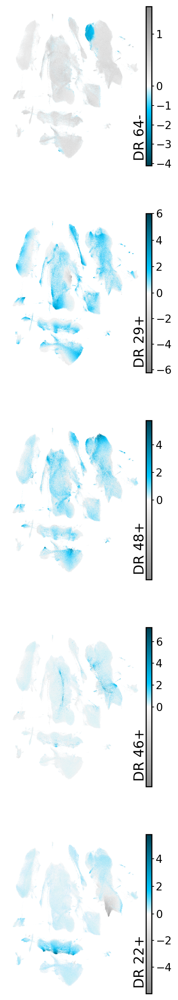

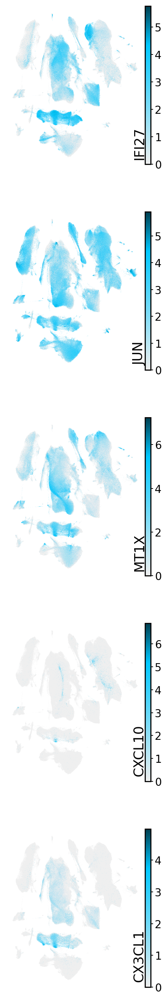

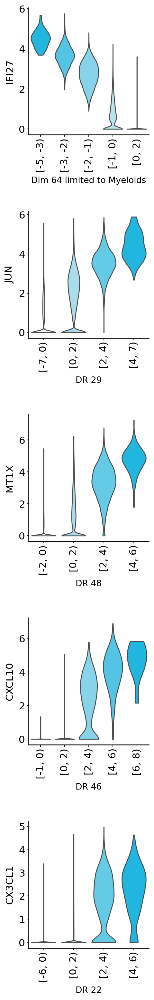

In [32]:
embed = embed_drvi

info_to_show = [
    (4, '-', 'IFI27', adata[adata.obs.query('ann_level_2 == "Myeloid"').index], 'Dim 64 limited to Myeloids'),
    (32, '+', 'JUN', adata, None),
    (63, '+', 'MT1X', adata, None),
    (27, '+', 'CXCL10', adata, None),
    (56, '+', 'CX3CL1', adata, None),
]

for i in range(3):
    # if i != 2:
    #     continue
        
    x = 4 * len(info_to_show)
    figsize = [(3, x), (3, x), (3, x*1.2)][i]
    fig, axes = plt.subplots(len(info_to_show), 1, 
                             figsize=figsize, 
                             squeeze=False)
    
    for row, (dim_id, direction, gene_name, adata_subset, violin_x_title) in enumerate(info_to_show):
        dim_id = dim_id - 1
        dim_title = embed.var.iloc[dim_id]['title'] + direction
        
        if i == 0:
            # Plot emb
            ax = axes[row, 0]
            embed.obs['_tmp'] = embed.X[:, dim_id].flatten().tolist()
            sc.pl.embedding(
                embed, 'X_umap', color='_tmp', vcenter=0, 
                cmap=drvi.utils.pl.cmap.saturated_sky_cmap if direction == '+' else drvi.utils.pl.cmap.saturated_sky_cmap.reversed(),
                show=False, frameon=False, ax=ax,
            )
            ax.text(0.92, 0.05, dim_title, size=15, ha='left', color='black', rotation=90, transform=ax.transAxes)
            ax.set_title("")
            # make colorbar smaller
            # cbar_ax = fig.axes[-1]
            # if hasattr(cbar_ax, "_colorbar"):
            #     color_bar_rescale_ratio = 0.8
            #     pos = cbar_ax.get_position()
            #     new_pos = [pos.x0, pos.y0, pos.width, pos.height * color_bar_rescale_ratio]
            #     cbar_ax.set_position(new_pos)
            del embed.obs['_tmp']

        if i == 1:
            # Plot gene
            ax = axes[row, 0]
            sc.pl.embedding(
                adata, 'X_umap_drvi', 
                color=gene_name, cmap=drvi.utils.pl.cmap.saturated_just_sky_cmap, 
                show=False, frameon=False, ax=ax
            )
            ax.text(0.92, 0.05, gene_name, size=15, ha='left', color='black', rotation=90, transform=ax.transAxes)
            ax.set_title("")

        if i == 2:
            # Violin plot
            ax = axes[row, 0]
            if violin_x_title is None:
                violin_x_title = dim_title[:-1]
            
            adata_subset = adata_subset.copy()
            adata_subset.obs[f'Discretized {dim_title}'] = list(embed[adata_subset.obs.index].X[:, dim_id].flatten())
            dim_max = adata_subset.obs[f'Discretized {dim_title}'].max()
            dim_min = adata_subset.obs[f'Discretized {dim_title}'].min()
            gap = 4.
            bins = []
            while len(bins) < 5:
                if direction == '+':
                    bins = [np.floor(dim_min)] + list(np.arange(0, dim_max + gap / 2, gap))
                    if bins[-1] < dim_max:
                        bins[-1] += 1
                else:
                    bins = list(-np.arange(0, -dim_min + gap / 2, gap)[::-1]) + [np.ceil(dim_max)]
                    if bins[0] > dim_min:
                        bins[0] -= 1
                gap /= 2
            gap *= 2
            if gap >= 1.:
                bins = np.asarray(bins).astype(int)
            adata_subset.obs[f'Discretized {dim_title}'] = pd.cut(adata_subset.obs[f'Discretized {dim_title}'], bins=bins, right=False, precision=0)
            adata_subset.obs[f'Discretized {dim_title}'] = adata_subset.obs[f'Discretized {dim_title}'].astype('category')
            n_colors = len(adata_subset.obs[f'Discretized {dim_title}'].unique())
            palette = sns.color_palette("light:#00c8ff", n_colors=n_colors, as_cmap=False)
            if direction == '-':
                palette = palette[::-1]
            sc.pl.violin(
                adata_subset, keys=gene_name, groupby=f'Discretized {dim_title}', palette=palette, stripplot=False, jitter=False, rotation=90, show=False, 
                xlabel=violin_x_title, ax=ax
            )
            ax.grid(False)
            ax.tick_params(axis='both', which='major', labelsize=14)
            ax.xaxis.label.set_fontsize(12)
    
    plt.subplots_adjust(hspace=0.6 if i==2 else 0.3, wspace=0.01)
    # plt.tight_layout()
    fig.savefig(output_dir / f'drvi_fig2__col_{i+1}.pdf', bbox_inches='tight', dpi=200)
    plt.show()

## Tumor adjacient dimension

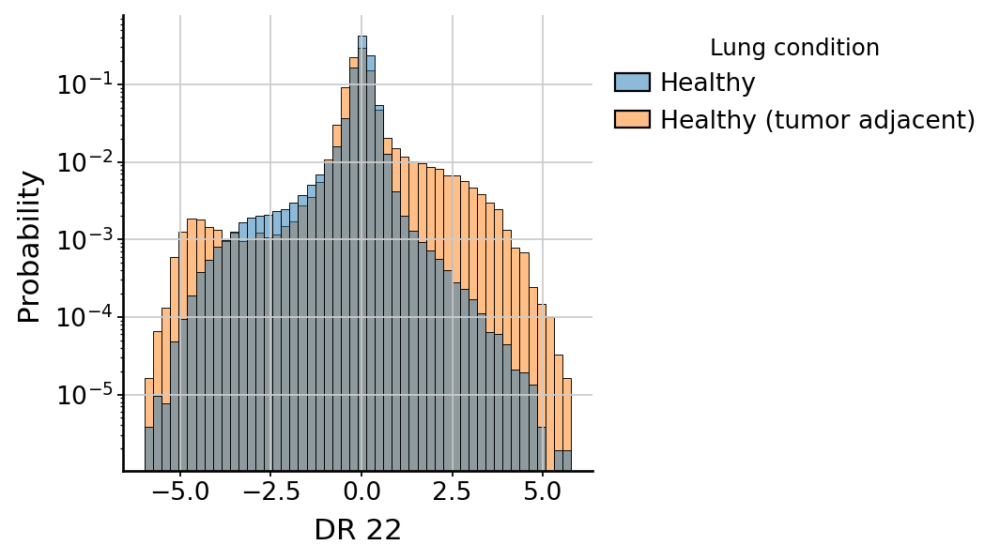

In [33]:
df = pd.DataFrame({
    'DR 22': embed.X[:, np.argmax(embed.var['title'] == 'DR 22')],
    'Lung condition': embed.obs['lung_condition'].values
})
ax = sns.histplot(data=df, bins=50, hue="Lung condition", x="DR 22", stat="probability", log_scale=False, common_norm=False)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.yscale('log')

plt.savefig(output_dir / f'histplot_dr_22_vs_lung_condition.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [34]:
embed.obs['ann_level_2'].unique()

['Lymphoid', 'Alveolar epithelium', 'Myeloid', 'Blood vessels', 'Airway epithelium', ..., 'Fibroblast lineage', 'Lymphatic EC', 'Smooth muscle', 'Mesothelium', 'Hematopoietic stem cells']
Length: 11
Categories (11, object): ['Airway epithelium', 'Alveolar epithelium', 'Blood vessels', 'Fibroblast lineage', ..., 'Mesothelium', 'Myeloid', 'Smooth muscle', 'Submucosal Gland']

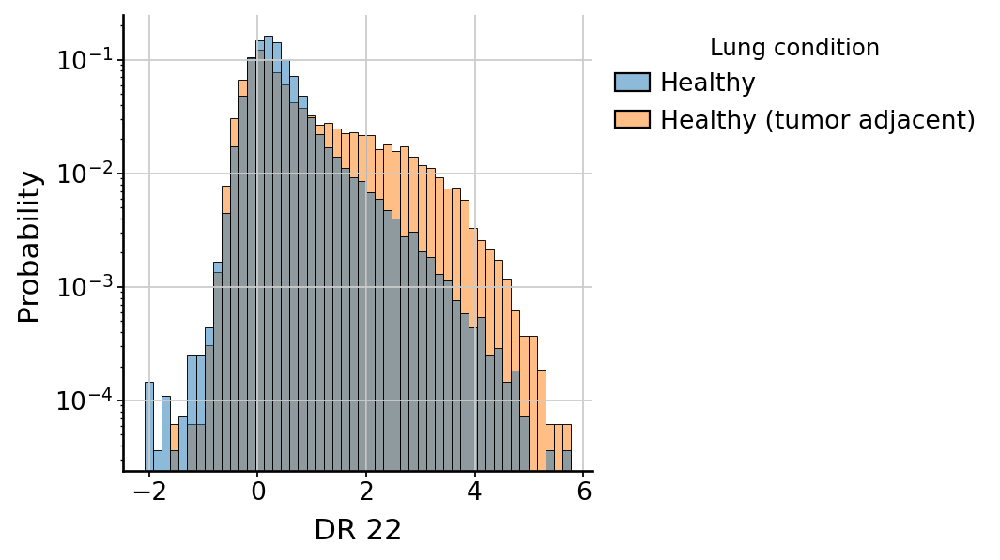

In [35]:
embed_subset = embed[embed.obs['ann_level_2'] == 'Blood vessels']
df = pd.DataFrame({
    'DR 22': embed_subset.X[:, np.argmax(embed_subset.var['title'] == 'DR 22')],
    'Lung condition': embed_subset.obs['lung_condition'].values
})
ax = sns.histplot(data=df, bins=50, hue="Lung condition", x="DR 22", stat="probability", log_scale=False, common_norm=False)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.yscale('log')

plt.savefig(output_dir / f'histplot_dr_22_vs_lung_condition_limit_blood_vessels.pdf', bbox_inches='tight', dpi=300)
plt.show()

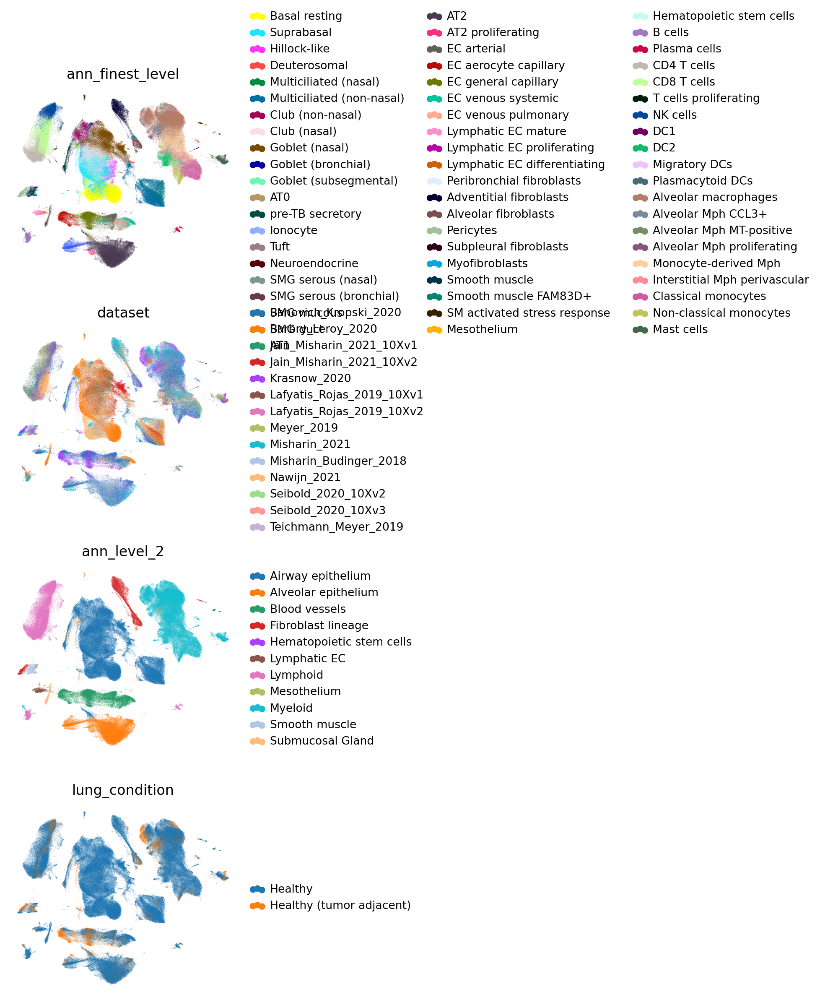

In [36]:
fig = sc.pl.embedding(
    embed, 'X_umap', color=[cell_type_key, condition_key, 'ann_level_2', 'lung_condition'], ncols=1, 
    show=False, frameon=False, return_fig=True,
)
plt.show()

DR 22+


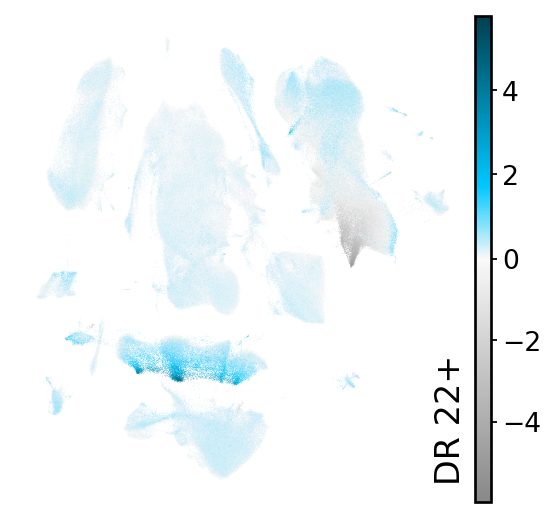

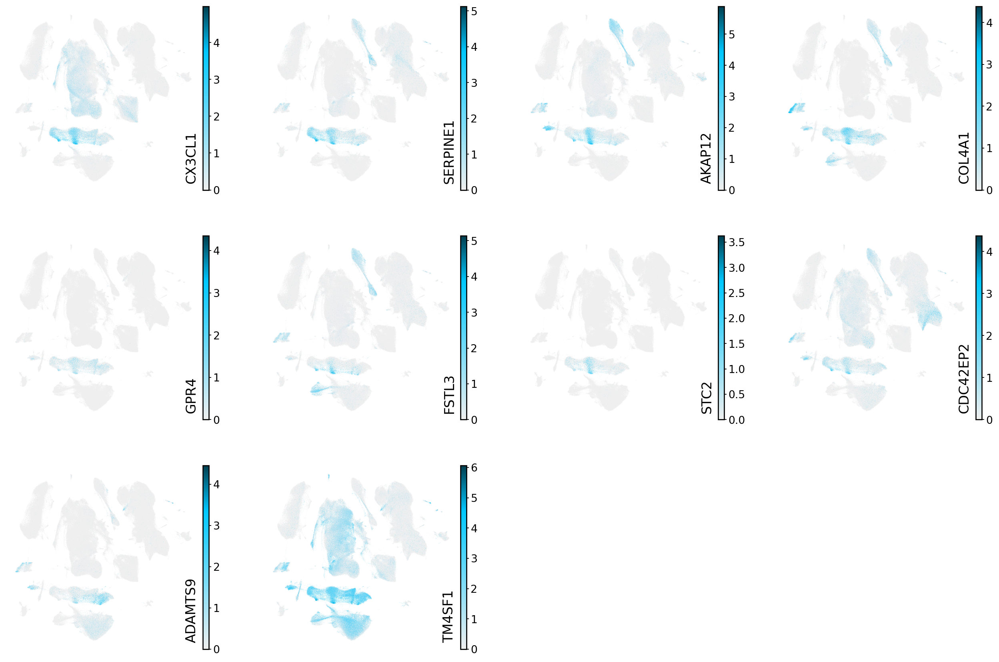

In [37]:
fig = drvi.utils.pl.plot_relevant_genes_on_umap(adata, embed, traverse_adata, "combined_score", score_threshold=0.0, n_top_genes=10,
                                                dim_subset=['DR 22+'])

# Clustering level for which rare cell-types emerge

In [38]:
if (RUNS_TO_LOAD['scVI'] / 'embed_with_multiple_res_leidens.h5ad').exists():
    embed_scvi = sc.read_h5ad(RUNS_TO_LOAD['scVI'] / 'embed_with_multiple_res_leidens.h5ad')
else:
    embed_scvi = embeds['scVI'].copy()
    sc.pp.neighbors(embed_scvi, use_rep="qz_mean", n_neighbors=10, n_pcs=embed_scvi.obsm["qz_mean"].shape[1])                
    embed_scvi

In [39]:
cluster_resolutions = [0.01, 0.2, 1., 1.5, 2., 2.5, 3., 3.5, 4., 5., 6., 7.0, 7.5, 8., 9., 10., 15., 20., 25.]
cluster_counts = {}
for res in cluster_resolutions:
    key_added = f'leiden_{res}'
    if key_added not in embed_scvi.obs.columns:
        sc.tl.leiden(embed_scvi, resolution=res, key_added=key_added)
    cluster_counts[key_added] = embed_scvi.obs[key_added].nunique()
    print(key_added, cluster_counts[key_added])

leiden_0.01 4
leiden_0.2 17
leiden_1.0 34
leiden_1.5 49
leiden_2.0 58
leiden_2.5 65
leiden_3.0 74
leiden_3.5 82
leiden_4.0 94
leiden_5.0 112
leiden_6.0 131
leiden_7.0 138
leiden_7.5 155
leiden_8.0 161
leiden_9.0 176
leiden_10.0 194
leiden_15.0 285
leiden_20.0 393
leiden_25.0 486


In [40]:
embed_scvi.write(RUNS_TO_LOAD['scVI'] / 'embed_with_multiple_res_leidens.h5ad')

In [41]:
dim_indicators = pd.DataFrame(
    np.vstack([
    (embed_drvi[embed_scvi.obs.index].X[:, np.argmax(embed.var['title'] == 'DR 39')] > 4.7) + 0.,
    (embed_drvi[embed_scvi.obs.index].X[:, np.argmax(embed.var['title'] == 'DR 32')] > 2) + 0.,
    (embed_drvi[embed_scvi.obs.index].X[:, np.argmax(embed.var['title'] == 'DR 26')] < -2.3) + 0.,
    (embed_drvi[embed_scvi.obs.index].X[:, np.argmax(embed.var['title'] == 'DR 34')] > 2.9) + 0.,
    ]).astype(int).T,
    columns = ['DR 39+', 'DR 32+', 'DR 26-', 'DR 34+']
)
dim_indicators[:3]

,DR 39+,DR 32+,DR 26-,DR 34+
0,0,0,0,0
1,0,0,0,0
2,0,0,0,0


In [42]:
from sklearn.metrics.pairwise import pairwise_distances
interesting_cts = [
    "AT0", "pre-TB secretory", "Migratory DCs", "Hillock-like",
]
ct_indicators = pd.get_dummies(embed_scvi.obs[cell_type_key])[interesting_cts] + 0.

# For finding thresholds
# aligned_cells = embed_drvi[embed_scvi.obs.index].X
# for thr in np.arange(0.5, 8, 0.1):
#     print(thr)
#     dim_indicators = pd.DataFrame(
#         np.vstack([
#         (aligned_cells[:, np.argmax(embed.var['title'] == 'DR 39')] > thr) + 0.,
#         (aligned_cells[:, np.argmax(embed.var['title'] == 'DR 32')] > thr) + 0.,
#         (aligned_cells[:, np.argmax(embed.var['title'] == 'DR 26')] < -thr) + 0.,
#         (aligned_cells[:, np.argmax(embed.var['title'] == 'DR 34')] > thr) + 0.,
#         ]).astype(int).T,
#         columns = ['DR 39+', 'DR 32+', 'DR 26-', 'DR 34+']
#     )
    
#     pairwise_jaccard = 1 - pairwise_distances(ct_indicators.values.T, dim_indicators.values.T, metric="jaccard", n_jobs=-1)
#     result = pd.DataFrame(pairwise_jaccard, index=interesting_cts, columns=dim_indicators.columns)
#     drvi_threshold_jaccard = result.max(axis=1)
#     print(drvi_threshold_jaccard)

pairwise_jaccard = 1 - pairwise_distances(ct_indicators.values.T, dim_indicators.values.T, metric="jaccard", n_jobs=-1)
result = pd.DataFrame(pairwise_jaccard, index=interesting_cts, columns=dim_indicators.columns)
drvi_threshold_jaccard = result.max(axis=1)
print(drvi_threshold_jaccard)

AT0                 0.259069
pre-TB secretory    0.430837
Migratory DCs       0.778393
Hillock-like        0.456097
dtype: float64


In [43]:
jaccard_results = {}
resolutions_to_plot = [0.01, 0.2, 1., 1.5, 2., 2.5, 3., 4., 5., 6., 7.0, 8., 9., 10.]
for res in cluster_resolutions:
    key_added = f'leiden_{res}'
    print("\n\n\n", key_added, embed_scvi.obs[key_added].nunique())
    cluster_indicators = pd.get_dummies(embed_scvi.obs[key_added]) + 0.
    pairwise_jaccard = 1 - pairwise_distances(ct_indicators.values.T, cluster_indicators.values.T, metric="jaccard", n_jobs=-1)
    result = pd.DataFrame(pairwise_jaccard, index=interesting_cts, columns=cluster_indicators.columns)
    jaccard_results[key_added] = result.max(axis=1)
    print(jaccard_results[key_added])

    if res not in resolutions_to_plot:
        del jaccard_results[key_added]




 leiden_0.01 4
AT0                 0.005104
pre-TB secretory    0.015559
Migratory DCs       0.001412
Hillock-like        0.016282
dtype: float64



 leiden_0.2 17
AT0                 0.100088
pre-TB secretory    0.174075
Migratory DCs       0.002141
Hillock-like        0.030187
dtype: float64



 leiden_1.0 34
AT0                 0.069313
pre-TB secretory    0.236883
Migratory DCs       0.027396
Hillock-like        0.291099
dtype: float64



 leiden_1.5 49
AT0                 0.209477
pre-TB secretory    0.577304
Migratory DCs       0.026004
Hillock-like        0.320632
dtype: float64



 leiden_2.0 58
AT0                 0.187709
pre-TB secretory    0.556799
Migratory DCs       0.021763
Hillock-like        0.277858
dtype: float64



 leiden_2.5 65
AT0                 0.193553
pre-TB secretory    0.571388
Migratory DCs       0.396761
Hillock-like        0.314963
dtype: float64



 leiden_3.0 74
AT0                 0.180244
pre-TB secretory    0.556370
Migratory DCs       0.396783
H

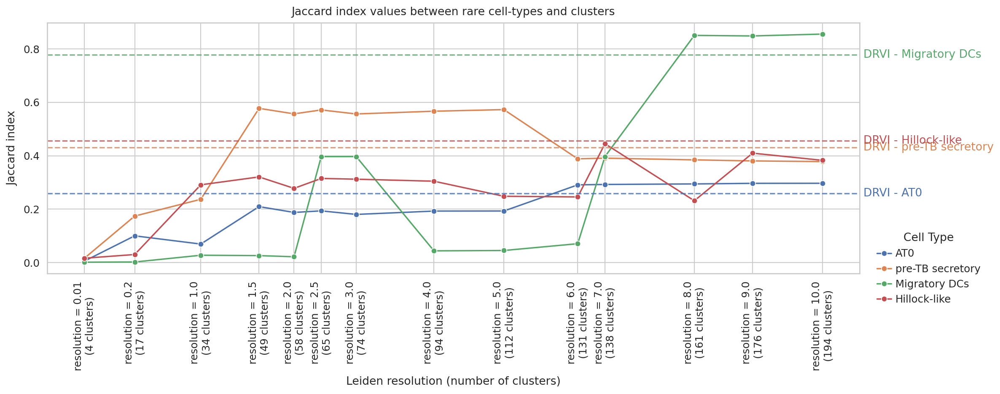

In [44]:
# Create a DataFrame from the dictionary
df = pd.DataFrame(jaccard_results)

# Reset the index so 'cell_type' becomes a column
df = df.reset_index().rename(columns={'index': 'cell_type'})

# Melt the DataFrame to long format for plotting
df_melted = df.melt(id_vars='cell_type', var_name='leiden_resolution', value_name='jaccard_value')

# Map resolutions to cluster counts
df_melted['cluster_count'] = df_melted['leiden_resolution'].map(cluster_counts)

# Sort by cluster count to keep x-axis in correct order
df_melted = df_melted.sort_values('cluster_count')

# Set up the seaborn style
sns.set(style="whitegrid")

# Create the line plot
plt.figure(figsize=(15, 6))
sns.lineplot(
    data=df_melted,
    x='cluster_count',
    y='jaccard_value',
    hue='cell_type',
    marker='o'
)

# Customize x-axis to display both resolution and cluster count
xticks = [cluster_counts[key] for key in cluster_counts if key in df.columns]
xlabels = []
for key in cluster_counts:
    if key in df.columns:
        res = key.split("_")[1]
        label = f'resolution = {res}\n({cluster_counts[key]} clusters)' 
        xlabels.append(label)
plt.xticks(ticks=xticks, labels=xlabels, rotation=90)

# Set plot titles and labels
plt.title('Jaccard index values between rare cell-types and clusters')
plt.xlabel('Leiden resolution (number of clusters)')
plt.ylabel('Jaccard index')

# Move the legend to the right
plt.legend(title='Cell Type', bbox_to_anchor=(1.01, 0.2), loc='upper left')

# Add dashed horizontal lines for fixed Jaccard values
for cell_type, fixed_value in drvi_threshold_jaccard.items():
    plt.axhline(
        y=fixed_value,
        color=sns.color_palette()[df['cell_type'].tolist().index(cell_type)],  # Match the color with the lines
        linestyle='--',
        label=f'{cell_type} (fixed)',
        alpha=0.8
    )
    # Add text next to the line
    plt.text(
        x=max(df_melted['cluster_count']) + 10.5,  # Position slightly to the right of the last x tick
        y=fixed_value,
        s=f'DRVI - {cell_type}',
        color=sns.color_palette()[df['cell_type'].tolist().index(cell_type)],  # Match the color with the line
        va='center'
    )

plt.tight_layout()
plt.savefig(output_dir / f'drvi_vs_clustering_rare_jaccard.pdf', bbox_inches='tight', dpi=300)
plt.show()

# Integration quality assessment

## Add scANVI to the scIB metrics

                                   X_scanvi_emb       Metric Type
isolated_labels                        0.682903  Bio conservation
nmi_ari_cluster_labels_kmeans_nmi      0.740950  Bio conservation
nmi_ari_cluster_labels_kmeans_ari      0.424533  Bio conservation
silhouette_label                       0.550711  Bio conservation
clisi_knn                              1.000000  Bio conservation
silhouette_batch                       0.904326  Batch correction
ilisi_knn                              0.020095  Batch correction
kbet_per_label                         0.229693  Batch correction
graph_connectivity                     0.949706  Batch correction
pcr_comparison                         0.664391  Batch correction


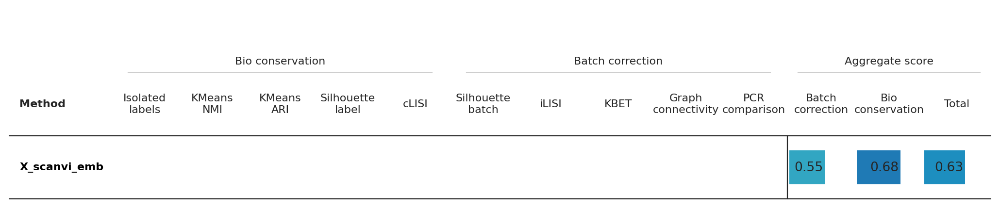

In [45]:
scib_metrics_save_path = RUNS_TO_LOAD['scVI'] / 'scib_metrics_original_emb.csv'
bench = Benchmarker(adata, condition_key, cell_type_key, embedding_obsm_keys=['X_scanvi_emb'])
if scib_metrics_save_path.exists():
    bench._results = pd.read_csv(scib_metrics_save_path, index_col=0)
else:
    bench.benchmark()
    bench._results.to_csv(scib_metrics_save_path)

scib_results_scanvi = bench._results
print(scib_results_scanvi)
bench.plot_results_table(min_max_scale=False, show=True)

SCIB for DRVI already calculated.
SCIB for DRVI-IK already calculated.
SCIB for scVI already calculated.
SCIB for PCA already calculated.
SCIB for ICA already calculated.
SCIB for MOFA already calculated.
SCIB for TCVAE-opt already calculated.
SCIB for MICHIGAN-opt already calculated.


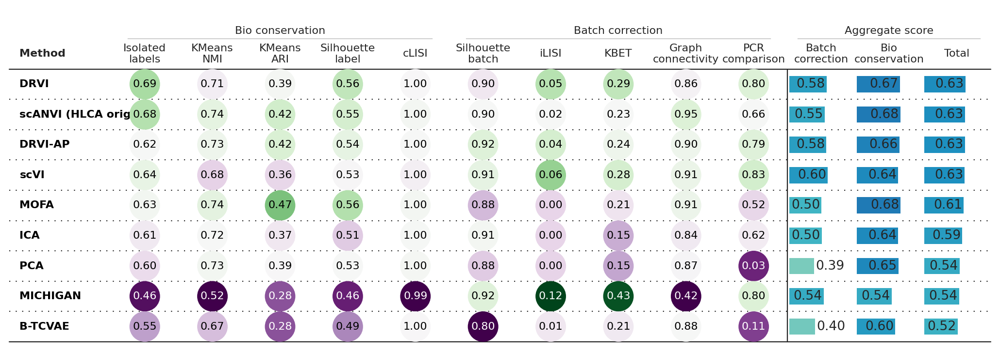

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public/plots/hlca_analysis/eval_integration_with_scanvi.svg')

In [46]:
methods_to_plot = [
    "X_scanvi_emb", "DRVI", "DRVI-IK", "scVI", 
    "TCVAE-opt", "MICHIGAN-opt", "PCA", "ICA", "MOFA"
]

results = {}
for method_name, run_path in RUNS_TO_LOAD.items():
    if method_name not in methods_to_plot:
        continue
    if str(run_path).endswith(".h5ad"):
        scib_metrics_save_path = str(run_path)[:-len(".h5ad")] + '_scib_metrics.csv'
    else:
        scib_metrics_save_path = run_path / 'scib_metrics.csv'
    print(f"SCIB for {method_name} already calculated.")
    results[method_name] = pd.read_csv(scib_metrics_save_path, index_col=0)
    results[method_name].columns = [method_name] + list(results[method_name].columns[1:])
results['X_scanvi_emb'] = scib_results_scanvi

results_prety = {}
for method_name, result_df in results.items():
    if method_name not in methods_to_plot:
        continue
    assert result_df.columns[0] == method_name
    result_df.rename(columns={method_name: pretify_method_name(method_name)}, inplace=True)
    results_prety[pretify_method_name(method_name)] = result_df

results = results_prety
bench = Benchmarker(adata, condition_key, cell_type_key, embedding_obsm_keys=results.keys())
any_result = results[list(results.keys())[0]]
bench._results = pd.concat([result_df.iloc[:, 0].fillna(0.) for method_name, result_df in results.items()] + [any_result[['Metric Type']]], axis=1, verify_integrity=True)
bench._results.rename(columns={'X_scanvi_emb': 'scANVI (HLCA original)'}, inplace=True)
bench.plot_results_table(min_max_scale=False, show=True, 
                         save_dir=output_dir)
shutil.move(output_dir / 'scib_results.svg', 
            output_dir / f'eval_integration_with_scanvi.svg')


## Remove confounding dim

In [47]:
embed = embeds['DRVI']
model = drvi.model.DRVI.load(RUNS_TO_LOAD['DRVI'] / 'model.pt', adata, prefix='v_0_1_0_')
drvi.utils.tl.set_latent_dimension_stats(model, embed)

INFO     File                                                                                                      
         /home/icb/amirali.moinfar/workspace/train_logs/models/drvi_20240307-160305-403359/model.pt/v_0_1_0_model.p
         t already downloaded                                                                                      
INFO     DRVI: The model has been initialized                                                                      


DR 29 is stress response to dissociation

In [48]:
embed_save_address = RUNS_TO_LOAD['DRVI'] / 'embed_without_dissociation_resp_dim.h5ad'

if embed_save_address.exists():
    embed_keep_vars = sc.read_h5ad(embed_save_address)
else:
    embed_keep_vars = embed[:, ~(embed.var['title'].isin(['DR 29']))].copy()

    sc.pp.neighbors(embed_keep_vars, n_neighbors=10, use_rep="X", n_pcs=embed_keep_vars.X.shape[1])
    sc.tl.umap(embed_keep_vars, spread=1.0, min_dist=0.5, random_state=123)
    sc.pp.pca(embed_keep_vars)

    embed_keep_vars.write(embed_save_address)

embed_keep_vars.shape

(584944, 63)

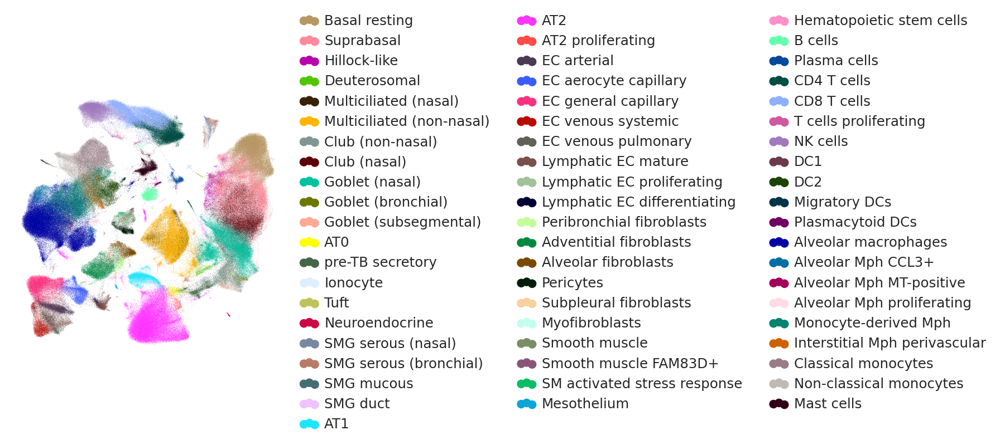

In [49]:
col = cell_type_key
unique_values = list(sorted(list(embed_keep_vars.obs[col].astype(str).unique())))
palette = dict(zip(unique_values, cat_100_pallete))
fig = sc.pl.umap(embed_keep_vars, color=col, 
                 palette = palette, 
                 show=False, frameon=False, title='', 
                 legend_loc='right margin',
                 colorbar_loc=None,
                 return_fig=True)
fig.savefig(output_dir / f'drvi_without_dissociation_resp_dim_umap_{col}.pdf', bbox_inches='tight', dpi=300)
plt.show()

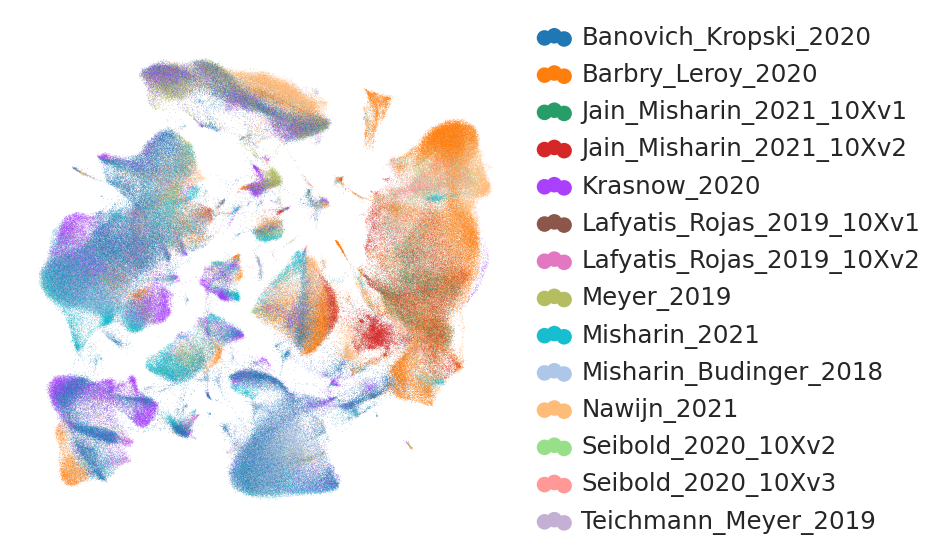

In [50]:
col = condition_key
fig = sc.pl.umap(embed_keep_vars, color=col, 
                 show=False, frameon=False, title='', 
                 legend_loc='right margin',
                 colorbar_loc=None,
                 return_fig=True)
fig.savefig(output_dir / f'drvi_without_dissociation_resp_dim_umap_{col}.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [51]:
adata.obsm['DRVI-pruned'] = embed_keep_vars[adata.obs.index].X

                                   DRVI-pruned       Metric Type
isolated_labels                       0.693987  Bio conservation
nmi_ari_cluster_labels_kmeans_nmi     0.714182  Bio conservation
nmi_ari_cluster_labels_kmeans_ari     0.410189  Bio conservation
silhouette_label                      0.560896  Bio conservation
clisi_knn                             0.999670  Bio conservation
silhouette_batch                      0.898109  Batch correction
ilisi_knn                             0.057534  Batch correction
kbet_per_label                        0.316502  Batch correction
graph_connectivity                    0.854100  Batch correction
pcr_comparison                        0.800528  Batch correction


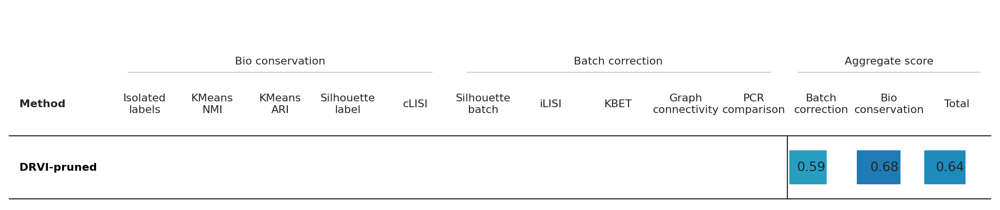

In [52]:
scib_metrics_save_path = RUNS_TO_LOAD['DRVI'] / 'scib_metrics_without_dissociation_resp_dim.csv'
bench = Benchmarker(adata, condition_key, cell_type_key, embedding_obsm_keys=['DRVI-pruned'])
if scib_metrics_save_path.exists():
    bench._results = pd.read_csv(scib_metrics_save_path, index_col=0)
else:
    bench.benchmark()
    bench._results.to_csv(scib_metrics_save_path)

scib_results_drvi_pruned = bench._results
print(scib_results_drvi_pruned)
bench.plot_results_table(min_max_scale=False, show=True)

SCIB for DRVI already calculated.
SCIB for DRVI-IK already calculated.
SCIB for scVI already calculated.


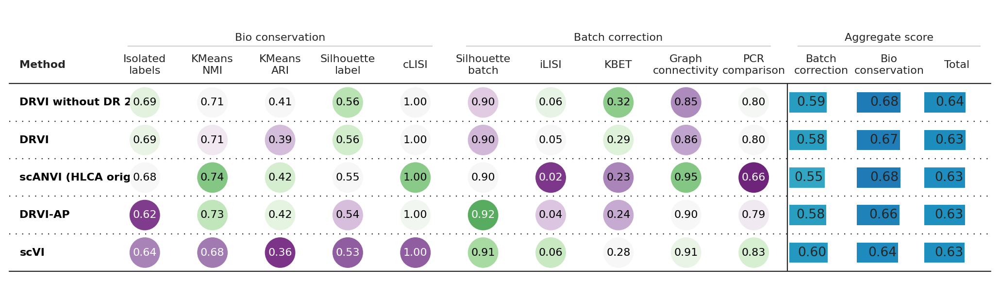

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public/plots/hlca_analysis/eval_integration_after_pruning_scib.svg')

In [53]:
methods_to_plot = [
    "X_scanvi_emb", "DRVI-pruned", "DRVI", "DRVI-IK", "scVI", 
]

results = {}
for method_name, run_path in RUNS_TO_LOAD.items():
    if method_name not in methods_to_plot:
        continue
    if str(run_path).endswith(".h5ad"):
        scib_metrics_save_path = str(run_path)[:-len(".h5ad")] + '_scib_metrics.csv'
    else:
        scib_metrics_save_path = run_path / 'scib_metrics.csv'
    print(f"SCIB for {method_name} already calculated.")
    results[method_name] = pd.read_csv(scib_metrics_save_path, index_col=0)
    results[method_name].columns = [method_name] + list(results[method_name].columns[1:])
results['DRVI-pruned'] = scib_results_drvi_pruned
results['X_scanvi_emb'] = scib_results_scanvi

results_prety = {}
for method_name, result_df in results.items():
    if method_name not in methods_to_plot:
        continue
    assert result_df.columns[0] == method_name
    result_df.rename(columns={method_name: pretify_method_name(method_name)}, inplace=True)
    results_prety[pretify_method_name(method_name)] = result_df

results = results_prety
bench = Benchmarker(adata, condition_key, cell_type_key, embedding_obsm_keys=results.keys())
any_result = results[list(results.keys())[0]]
bench._results = pd.concat([result_df.iloc[:, 0].fillna(0.) for method_name, result_df in results.items()] + [any_result[['Metric Type']]], axis=1, verify_integrity=True)
bench._results.rename(columns={'X_scanvi_emb': 'scANVI (HLCA original)',
                               'DRVI-pruned': 'DRVI without DR 29'}, inplace=True)
bench.plot_results_table(min_max_scale=False, show=True, 
                         save_dir=output_dir)
shutil.move(output_dir / 'scib_results.svg', 
            output_dir / f'eval_integration_after_pruning_scib.svg')
